In [1]:
pip install opencv-python matplotlib Pillow numpy  seaborn scikit-learn ipykernel tensorflow

  Using cached absl_py-2.3.1-py3-none-any.whl.metadata (3.3 kB)
  Using cached astunparse-1.6.3-py2.py3-none-any.whl.metadata (4.4 kB)
  Using cached flatbuffers-25.9.23-py2.py3-none-any.whl.metadata (875 bytes)
  Using cached google_pasta-0.2.0-py3-none-any.whl.metadata (814 bytes)
  Using cached libclang-18.1.1-1-py2.py3-none-macosx_11_0_arm64.whl.metadata (5.2 kB)
  Using cached opt_einsum-3.4.0-py3-none-any.whl.metadata (6.3 kB)
  Using cached requests-2.32.5-py3-none-any.whl.metadata (4.9 kB)
  Using cached termcolor-3.2.0-py3-none-any.whl.metadata (6.4 kB)
  Using cached typing_extensions-4.15.0-py3-none-any.whl.metadata (3.3 kB)
  Using cached tensorboard-2.20.0-py3-none-any.whl.metadata (1.8 kB)
  Using cached keras-3.12.0-py3-none-any.whl.metadata (5.9 kB)
  Using cached idna-3.11-py3-none-any.whl.metadata (8.4 kB)
  Using cached certifi-2025.11.12-py3-none-any.whl.metadata (2.5 kB)
  Using cached markdown-3.10-py3-none-any.whl.metadata (5.1 kB)
  Using cached tensorboard_data

# Manual ejercicios básicos de Procesamiento de Información Visual mediante con Python y OpenCV
---
**Autor:** Francisco J. Martínez Mimbrera
**Año:** 2025

Este manual recopila los ejercicios resueltos desde el procesamiento básico hasta el flujo óptico y redes neuronales.

# Tema 2: Procesamiento básico con OpenCV y Python
### Ejercicios resueltos de procesamiento básico de imágenes

Este cuaderno contiene 15 ejercicios prácticos diseñados para afianzar los conocimientos de visión artificial. 

**Requisitos:**
* OpenCV (`pip install opencv-python`)
* Matplotlib (`pip install matplotlib`)
* Pillow (`pip install Pillow`)
* NumPy (`pip install numpy`)
* SeaBorn (`pip install seaborn`)
* Scikit-Learn (`pip install scikit-learn`)


Nota importante: Se propone usar un cambio con respecto al código que aparece resuelto en el manual, ya que para mostrar la imagen, se proponía en cada ejercicio cargarla y trabajar con ella y aquí solo se carga una vez. Asimismo, como OpenCV carga las imágenes en formato BGR, mientras que Matplotlib las muestra en RGB,  realizaremos la conversión de visualización, debido a que jupyternotebook puede dar problemas el mostrar la imagen usando openCV directamente. Esto viene propiciado porque que al ejecutarse en un navegador web, al hacer llamadas al sistema OpenCV de ventanas para S.O puede quedarse el kernel de python colgado.

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ExifTags

def mostrar_imagen(img, titulo="Imagen", es_gris=False):
    plt.figure(figsize=(8, 6))
    if es_gris:
        plt.imshow(img, cmap='gray')
    else:
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.imshow(img_rgb)
    plt.title(titulo)
    plt.axis('off')
    plt.show()

# Intentar cargar imagen base
img = cv2.imread('imagen.jpg')
if img is None:
    print("Error: No se encontró 'imagen.jpg'. Coloca una imagen con ese nombre en la carpeta.")
# Intentar cargar imagen base
img2 = cv2.imread('imagenbordes.jpg')
if img2 is None:
    print("Error: No se encontró 'imagenbordes.jpg'. Coloca una imagen con ese nombre en la carpeta.")
img3 = cv2.imread('imagencopia.jpg')
if img3 is None:
    print("Error: No se encontró 'imagenbordes.jpg'. Coloca una imagen con ese nombre en la carpeta.")    

## 1. Leer, mostrar e imprimir información

Dimensiones: (3024, 4032, 3)


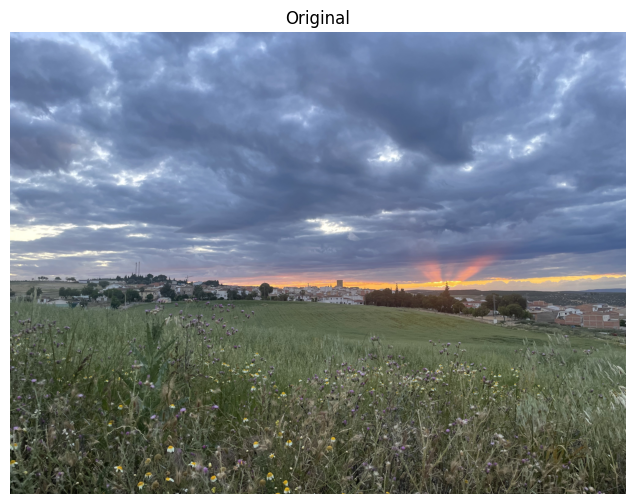

In [6]:
if img is not None:
    print(f"Dimensiones: {img.shape}")
    mostrar_imagen(img, "Original")

## 2. Escala de grises

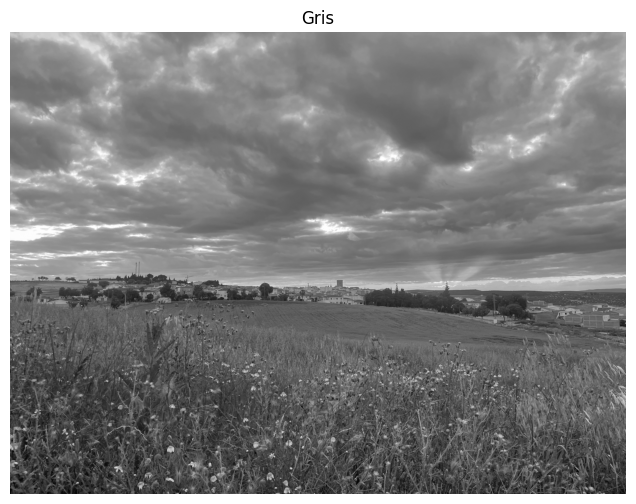

In [7]:
img_gris = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
mostrar_imagen(img_gris, "Gris", es_gris=True)

## 3. Filtro Gaussiano

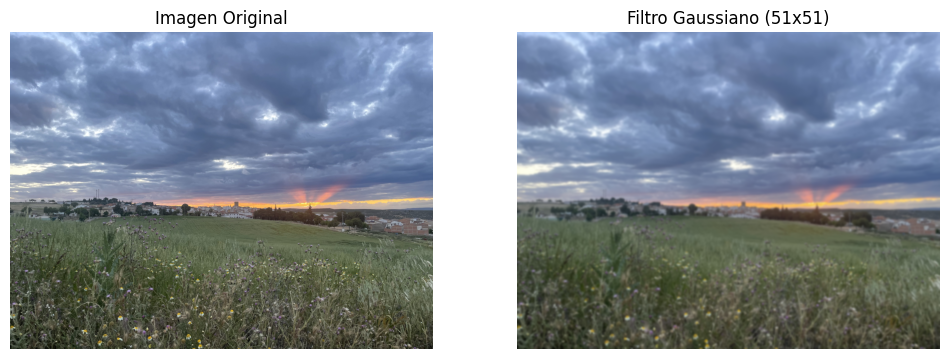

In [8]:
import matplotlib.pyplot as plt
import cv2

# Aplicamos el filtro 
img_gauss = cv2.GaussianBlur(img, (51, 51), 0)


plt.figure(figsize=(12, 6))


plt.subplot(1, 2, 1) # (filas, columnas, índice)
img_rgb_orig = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 
plt.imshow(img_rgb_orig)
plt.title("Imagen Original")
plt.axis('off')

plt.subplot(1, 2, 2)
img_rgb_gauss = cv2.cvtColor(img_gauss, cv2.COLOR_BGR2RGB) 
plt.imshow(img_rgb_gauss)
plt.title("Filtro Gaussiano (51x51)")
plt.axis('off')

plt.show()

## 4. Recorte básico

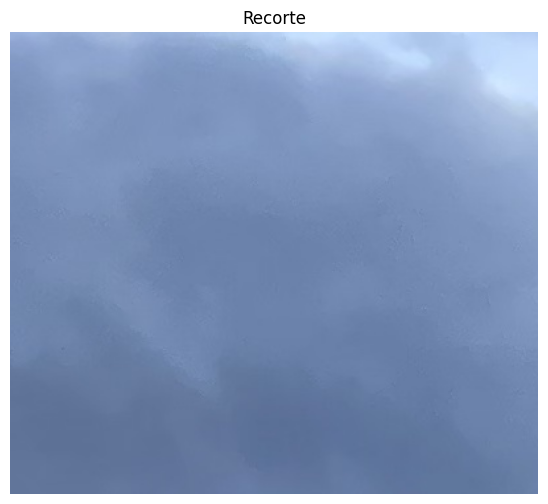

In [97]:
recorte = img[50:400, 100:500]
mostrar_imagen(recorte, "Recorte")

## 5. Rotación simple

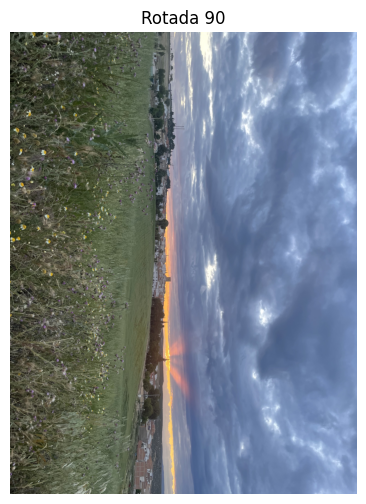

In [9]:
img_rot = cv2.rotate(img, cv2.ROTATE_90_CLOCKWISE)
mostrar_imagen(img_rot, "Rotada 90")

## 6. Invertir colores

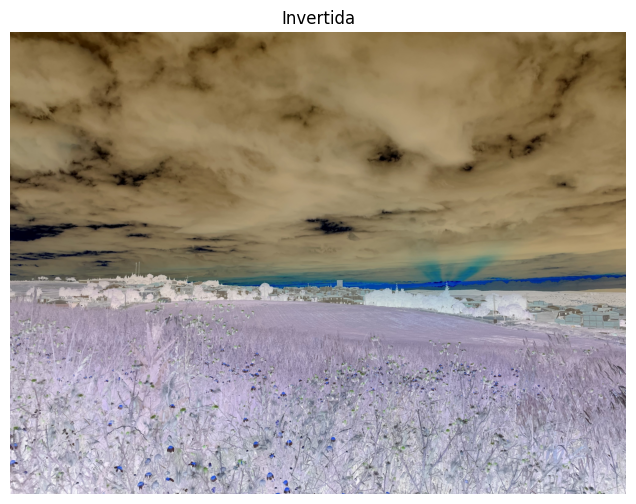

In [10]:
img_inv = 255 - img
mostrar_imagen(img_inv, "Invertida")

## 7. Brillo y Contraste

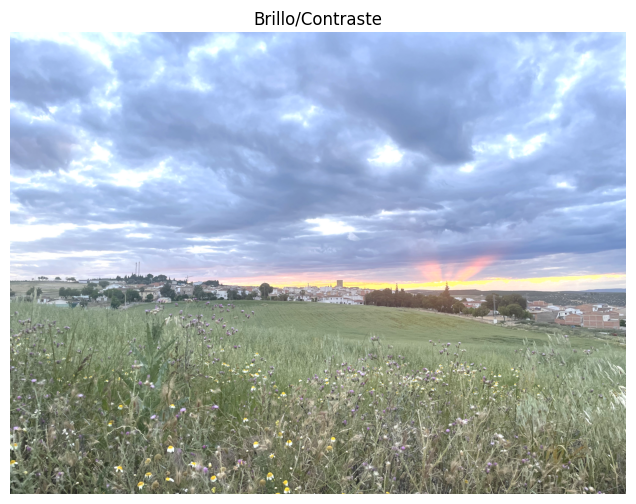

In [11]:
img_bc = cv2.convertScaleAbs(img, alpha=1.2, beta=30)
mostrar_imagen(img_bc, "Brillo/Contraste")

## 8. Región de Interés (ROI)

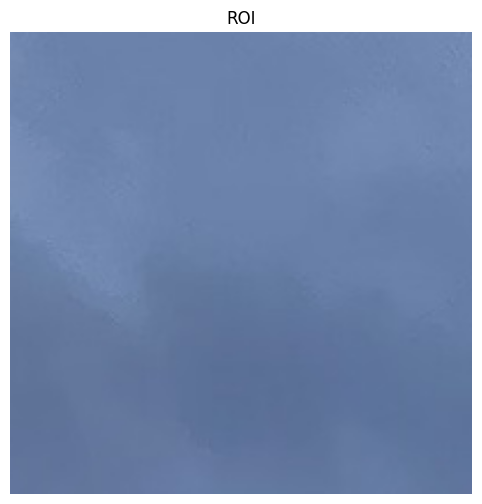

In [101]:
roi = img[200:400, 200:400]
mostrar_imagen(roi, "ROI")

## 9. Rotación arbitraria

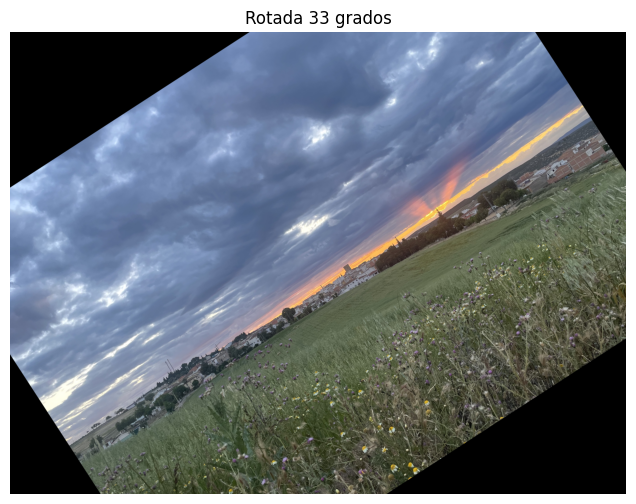

In [102]:
(h, w) = img.shape[:2]
M = cv2.getRotationMatrix2D((w//2, h//2), 33, 1.0)
img_33 = cv2.warpAffine(img, M, (w, h))
mostrar_imagen(img_33, "Rotada 33 grados")

## 10. Reflejar (Flip)

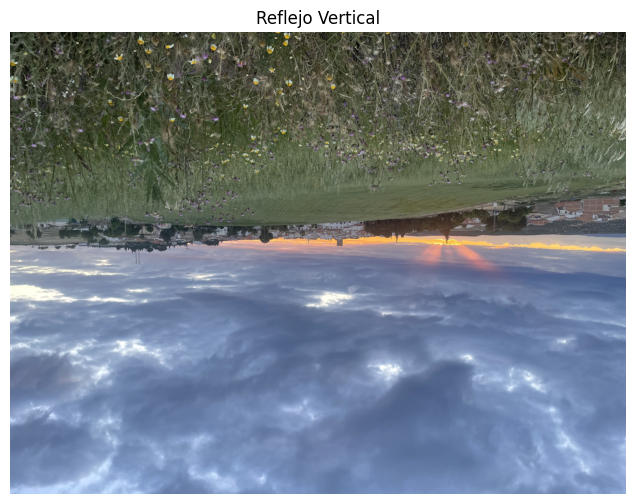

In [103]:
flip_v = cv2.flip(img, 0)
mostrar_imagen(flip_v, "Reflejo Vertical")

## 11. Metadatos EXIF

In [104]:
try:
    pil_img = Image.open('imagen.jpg')
    info = pil_img._getexif()
    if info:
        for tag, value in info.items():
            decoded = ExifTags.TAGS.get(tag, tag)
            print(f"{decoded}: {value}")
except:
    print("No se pudieron leer metadatos.")

TileWidth: 512
TileLength: 512
GPSInfo: {1: 'N', 2: (37.0, 57.0, 59.47), 3: 'W', 4: (3.0, 47.0, 44.98), 5: b'\x00', 6: 308.31771475544593, 7: (19.0, 8.0, 58.0), 12: 'K', 13: 0.0, 16: 'T', 17: 284.68055725284125, 23: 'T', 24: 284.68055725284125, 29: '2025:05:10', 31: 3.5355339046563916}
ResolutionUnit: 2
ExifOffset: 240
Make: Apple
Model: iPhone 12
Software: 18.4.1
Orientation: 1
DateTime: 2025:05:10 21:09:00
XResolution: 72.0
YResolution: 72.0
HostComputer: iPhone 12
ExifVersion: b'0232'
ShutterSpeedValue: 6.922789819228348
ApertureValue: 1.3561438092556088
DateTimeOriginal: 2025:05:10 21:09:00
DateTimeDigitized: 2025:05:10 21:09:00
BrightnessValue: 4.747915701713756
ExposureBiasValue: 0.0
MeteringMode: 5
ColorSpace: 65535
Flash: 16
FocalLength: 4.2
ExifImageWidth: 4032
ExifImageHeight: 3024
FocalLengthIn35mmFilm: 26
OffsetTime: +02:00
OffsetTimeOriginal: +02:00
OffsetTimeDigitized: +02:00
SubsecTimeOriginal: 341
SubjectLocation: (2012, 1510, 2217, 1393)
SubsecTimeDigitized: 341
Sensin

## 12. Espacios de Color

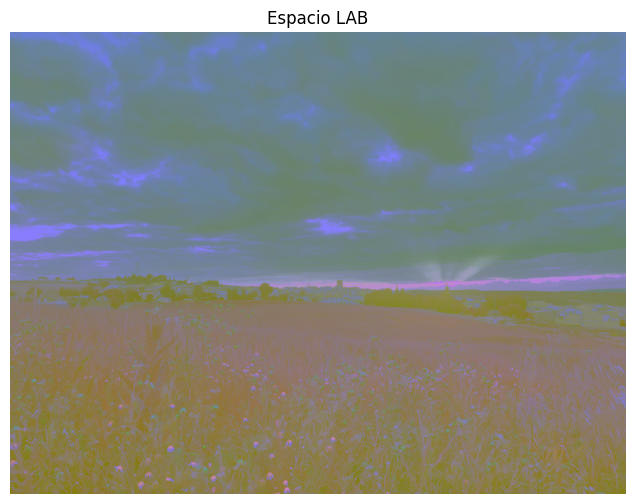

In [105]:
img_lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
mostrar_imagen(img_lab, "Espacio LAB")

## 13. Desenfoque (Blur)

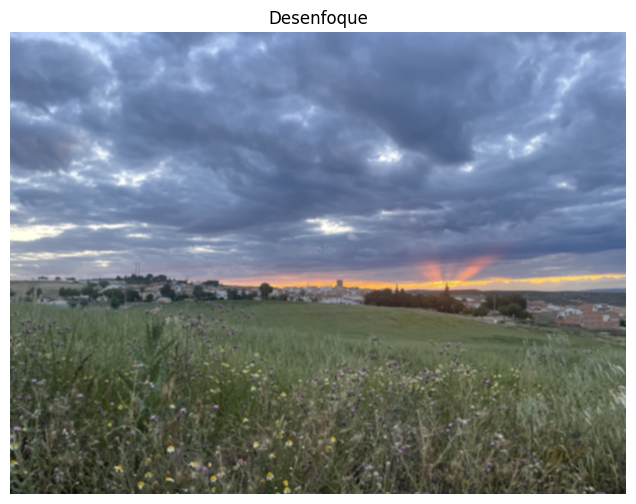

In [106]:
img_blur = cv2.blur(img, (15, 15))
mostrar_imagen(img_blur, "Desenfoque")

## 14. Dibujar Formas

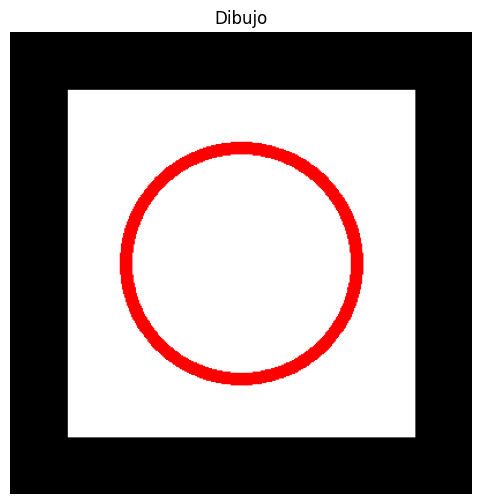

In [107]:
canvas = np.zeros((400, 400, 3), dtype="uint8")
cv2.rectangle(canvas, (50, 50), (350, 350), (255, 255, 255), -1)
cv2.circle(canvas, (200, 200), 100, (0, 0, 255), 10)
mostrar_imagen(canvas, "Dibujo")

## 15. Canales de color

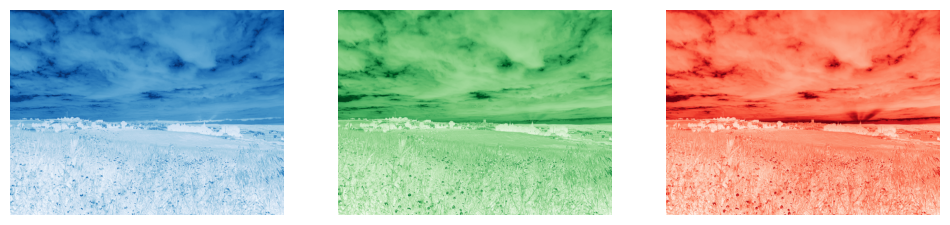

In [108]:
b, g, r = cv2.split(img)
plt.figure(figsize=(12,4))
plt.subplot(131); plt.imshow(b, cmap='Blues'); plt.axis('off')
plt.subplot(132); plt.imshow(g, cmap='Greens'); plt.axis('off')
plt.subplot(133); plt.imshow(r, cmap='Reds'); plt.axis('off')
plt.show()

# Tema3: Cálculo y visualización de histogramas

En este capítulo se abordará el estudio de los histogramas, una de las herramientas fundamentales en el procesamiento digital de imágenes. Un **histograma** es una representación gráfica que muestra la distribución de las intensidades de los píxeles, permitiendo analizar de manera visual y cuantitativa aspectos críticos como el contraste, el brillo y el rango dinámico.

## 1. Histograma en escala de grises
Transforma la imagen a escala de grises y genera un histograma unidimensional (0-255).

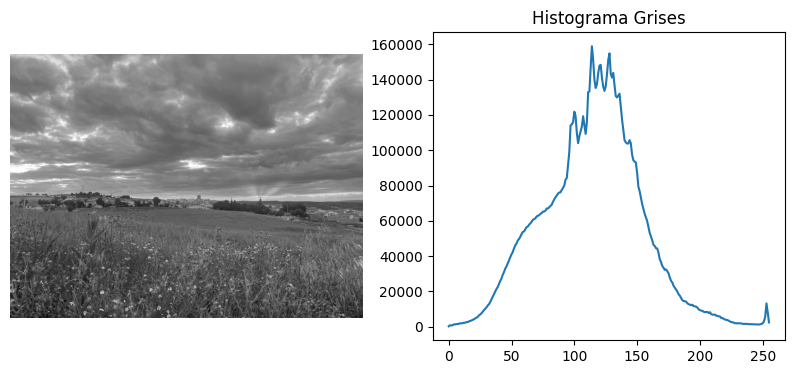

In [3]:
gris = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
hist = cv2.calcHist([gris], [0], None, [256], [0, 256])

plt.figure(figsize=(10, 4))
plt.subplot(121); plt.imshow(gris, cmap='gray'); plt.axis('off')
plt.subplot(122); plt.plot(hist); plt.title('Histograma Grises')
plt.show()

## 2. Histogramas de cada canal de color (RGB)
Descompone la imagen en sus componentes básicos para identificar sesgos cromáticos.

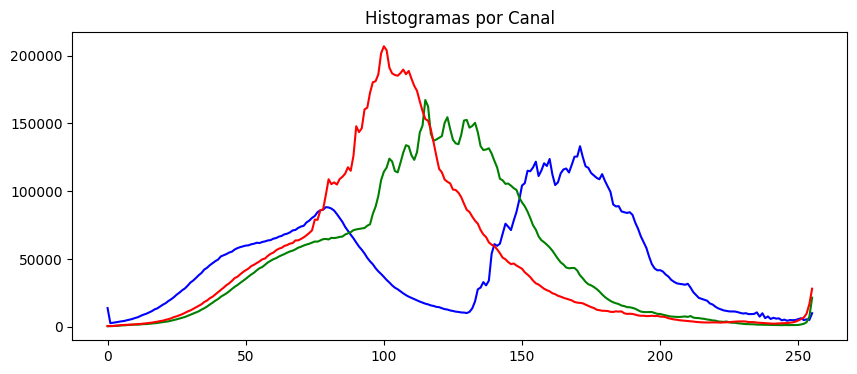

In [4]:
colores = ('b', 'g', 'r')
plt.figure(figsize=(10, 4))
for i, col in enumerate(colores):
    hist = cv2.calcHist([img], [i], None, [256], [0, 256])
    plt.plot(hist, color=col)
plt.title('Histogramas por Canal')
plt.show()

## 3. Histograma acumulado
Suma las frecuencias de los niveles inferiores o iguales al valor actual.

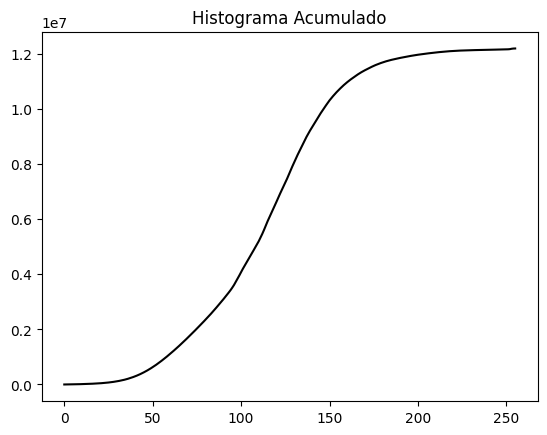

In [5]:
hist = cv2.calcHist([gris], [0], None, [256], [0, 256])
hist_acc = hist.cumsum()
plt.plot(hist_acc, color='black')
plt.title('Histograma Acumulado')
plt.show()

## 4. Histograma de un área seleccionada (ROI)
Uso de máscaras para aislar una región específica.

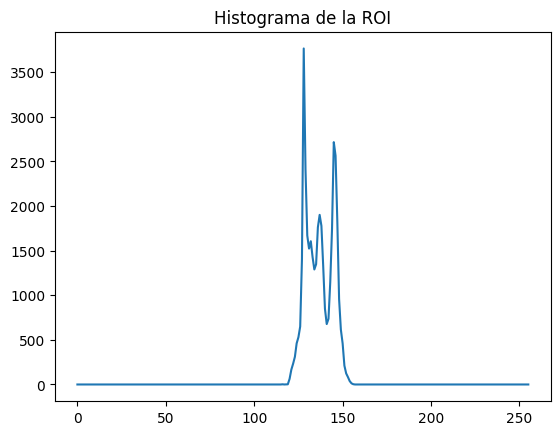

In [5]:
mask = np.zeros(gris.shape, dtype="uint8")
cv2.rectangle(mask, (100, 100), (300, 300), 255, -1)
hist_roi = cv2.calcHist([gris], [0], mask, [256], [0, 256])
plt.plot(hist_roi)
plt.title('Histograma de la ROI')
plt.show()

## 5. Comparar dos histogramas
Uso de correlación para medir similitud.

In [6]:
# Comparar la imagen con una versión más brillante
img2 = cv2.convertScaleAbs(img, alpha=1.2, beta=30)
h1 = cv2.calcHist([img], [0], None, [256], [0, 256])
h2 = cv2.calcHist([img2], [0], None, [256], [0, 256])
similitud = cv2.compareHist(h1, h2, cv2.HISTCMP_CORREL)
print(f"Similitud (Correlación): {similitud:.4f}")

Similitud (Correlación): -0.2022


## 6. Canal de Matiz (HSV)
Análisis cromático independiente de la iluminación.

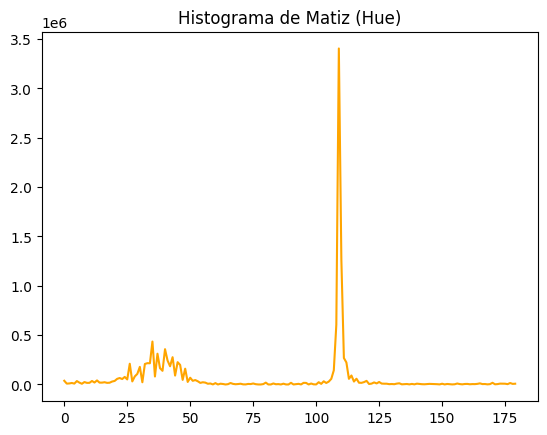

In [7]:
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
hist_h = cv2.calcHist([hsv], [0], None, [180], [0, 180])
plt.plot(hist_h, color='orange')
plt.title('Histograma de Matiz (Hue)')
plt.show()

## 7. RGB Superpuestos
Visualización comparativa con transparencias.

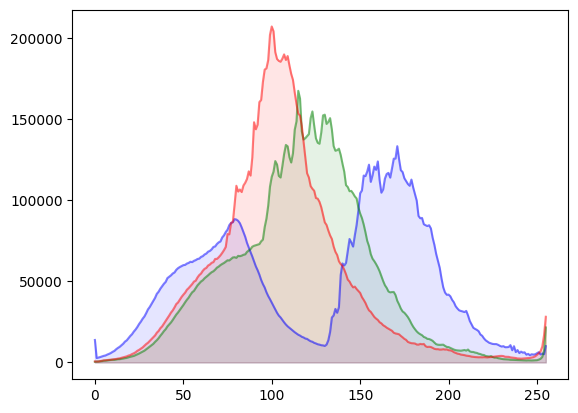

In [8]:
for i, col in enumerate(('b', 'g', 'r')):
    hist = cv2.calcHist([img], [i], None, [256], [0, 256])
    plt.plot(hist, color=col, alpha=0.5)
    plt.fill_between(range(256), hist.flatten(), color=col, alpha=0.1)
plt.show()

## 8. Histograma 2D (H-S)
Relación entre color y pureza.

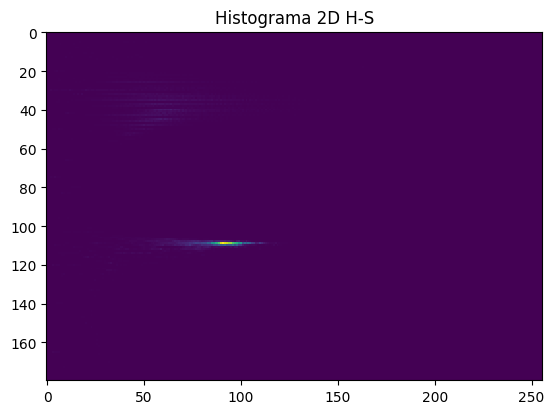

In [9]:
hist2d = cv2.calcHist([hsv], [0, 1], None, [180, 256], [0, 180, 0, 256])
plt.imshow(hist2d, interpolation='nearest')
plt.title('Histograma 2D H-S')
plt.show()

## 9. Parámetros Estadísticos

In [7]:
print(f"Media: {np.mean(gris):.2f}")
print(f"Desviación: {np.std(gris):.2f}")

Media: 114.89
Desviación: 38.48


## 10. Histograma dinámico (Nota)
Nota: Los bucles de video requieren ejecución local para acceder a la webcam.

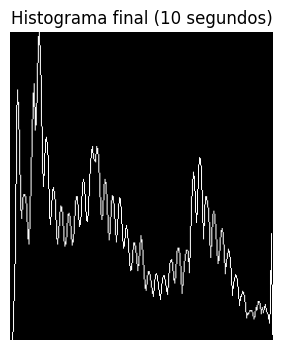

In [4]:
import cv2
import numpy as np
import time
import matplotlib.pyplot as plt


cap = cv2.VideoCapture(0)
if not cap.isOpened():
    print("Error cámara")
    exit()

cv2.namedWindow("Cámara", cv2.WINDOW_NORMAL)

start = time.time()
hist_acum = np.zeros((256, 1), dtype=np.float32)

# CAPTURA 10 SEGUNDOS
while time.time() - start < 10:
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    hist = cv2.calcHist([gray], [0], None, [256], [0, 256])
    hist_acum += hist

    cv2.imshow("Cámara", frame)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyWindow("Cámara")  


hist_acum = cv2.normalize(hist_acum, None, 0, 300, cv2.NORM_MINMAX)
canvas = np.zeros((300, 256), dtype="uint8")

for i in range(1, 256):
    cv2.line(
        canvas,
        (i - 1, 300 - int(hist_acum[i - 1][0])),
        (i,     300 - int(hist_acum[i][0])),
        255, 1
    )

cv2.namedWindow("Histograma final (10s)", cv2.WINDOW_NORMAL)
cv2.imshow("Histograma final (10s)", canvas)

cv2.waitKey(0)            
cv2.destroyAllWindows()

# Mostrar histograma final en el notebook
plt.figure(figsize=(8, 4))
plt.imshow(canvas, cmap="gray")
plt.title("Histograma final (10 segundos)")
plt.axis("off")
plt.show()


## 11. Máscara Circular

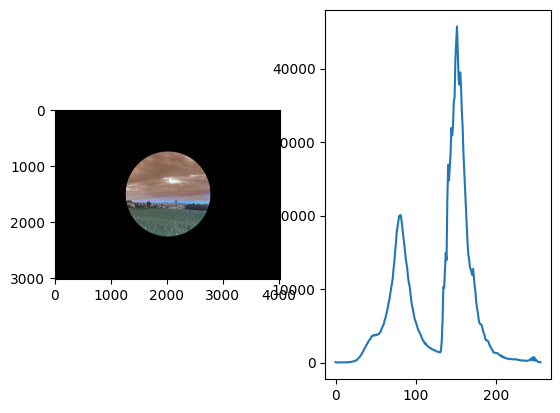

In [3]:
h, w = img.shape[:2]

mask = np.zeros(img.shape[:2], np.uint8)
cv2.circle(mask, (w//2, h//2), min(w, h)//4, 255, -1)

hist_mask = cv2.calcHist([img], [0], mask, [256], [0, 256])

plt.subplot(121), plt.imshow(cv2.bitwise_and(img, img, mask=mask), cmap='gray')
plt.subplot(122), plt.plot(hist_mask)
plt.show()



## 12. Detección de Exposición

In [6]:
hist = cv2.calcHist([img], [0], None, [256], [0, 256])

total_píxeles = img.shape[0] * img.shape[1]
subexpuestos = (hist[0] / total_píxeles) * 100
sobreexpuestos = (hist[255] / total_píxeles) * 100

print(f"Porcentaje píxeles negros: {subexpuestos[0]:.2f}%")
print(f"Porcentaje píxeles blancos: {sobreexpuestos[0]:.2f}%")

if subexpuestos > 5: print("Alerta: Posible imagen subexpuesta")
if sobreexpuestos > 5: print("Alerta: Posible imagen sobreexpuesta (quemada)")


Porcentaje píxeles negros: 0.11%
Porcentaje píxeles blancos: 0.08%


## 13. Distancia Bhattacharyya

In [13]:

# Calcular los histogramas (por ejemplo, del canal 0 / Azul)
hist_img = cv2.calcHist([img], [0], None, [256], [0, 256])
hist_img3 = cv2.calcHist([img3], [0], None, [256], [0, 256])

# NORMALIZAR (Paso crítico para la distancia Bhattacharyya)
# Esto hace que los valores estén en un rango comparable (0 a 1)
cv2.normalize(hist_img, hist_img, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX)
cv2.normalize(hist_img3, hist_img3, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX)


dist = cv2.compareHist(hist_img, hist_img3, cv2.HISTCMP_BHATTACHARYYA)

print(f"Distancia Bhattacharyya: {dist:.4f}")

Distancia Bhattacharyya: nan


## 14. Espacio CIELAB

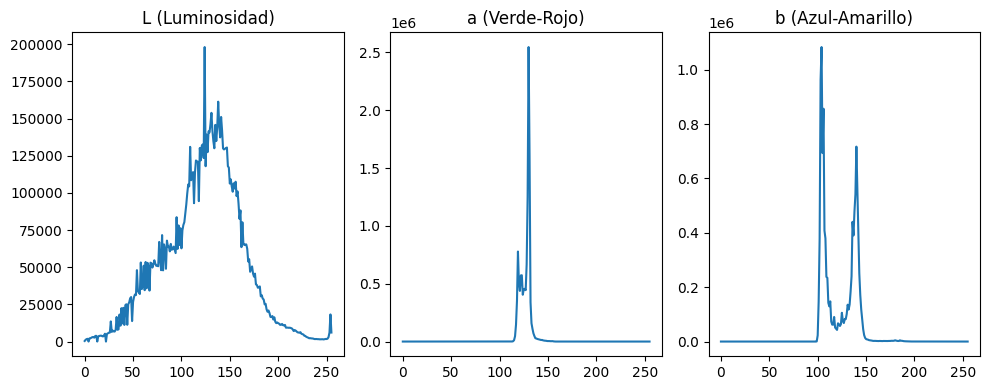

In [15]:
lab = cv2.cvtColor(img, cv2.COLOR_BGR2Lab)
l, a, b = cv2.split(lab)

plt.figure(figsize=(10,4))
plt.subplot(131), plt.plot(cv2.calcHist([l],[0],None,[256],[0,256])), plt.title('L (Luminosidad)')
plt.subplot(132), plt.plot(cv2.calcHist([a],[0],None,[256],[0,256])), plt.title('a (Verde-Rojo)')
plt.subplot(133), plt.plot(cv2.calcHist([b],[0],None,[256],[0,256])), plt.title('b (Azul-Amarillo)')
plt.tight_layout()
plt.show()



## 15. Línea de Perfil

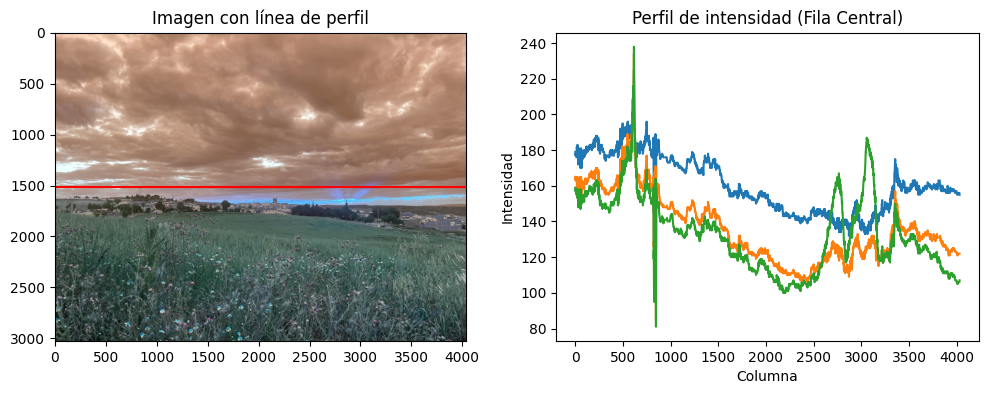

In [19]:

# Definir una línea horizontal a la mitad de la imagen
fila = h // 2
perfil = img[fila, :]

plt.figure(figsize=(12, 4))
plt.subplot(121)
plt.imshow(img, cmap='gray')
plt.axhline(y=fila, color='r')
plt.title('Imagen con línea de perfil')

plt.subplot(122)
plt.plot(perfil)
plt.title('Perfil de intensidad (Fila Central)')
plt.xlabel('Columna')
plt.ylabel('Intensidad')
plt.show()



# Tema4: Igualación de histogramas y convoluciones

En este capítulo se exploran técnicas fundamentales para la mejora y transformación de imágenes en el dominio espacial. El procesamiento se divide en dos grandes bloques: la modificación del contraste y el filtrado mediante núcleos.

1. **Igualación de Histogramas**: Maximización del rango dinámico.
2. **Convolución**: Operación matemática para aplicar filtros (suavizado, bordes, realce).

In [20]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def comparar(original, procesado, titulo_p="Procesada", es_gris=False):
    plt.figure(figsize=(12, 6))
    
    plt.subplot(121)
    if len(original.shape) == 2 or es_gris:
        plt.imshow(original, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(original, cv2.COLOR_BGR2RGB))
    plt.title("Original")
    plt.axis('off')
    
    plt.subplot(122)
    if len(procesado.shape) == 2 or es_gris:
        plt.imshow(procesado, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(procesado, cv2.COLOR_BGR2RGB))
    plt.title(titulo_p)
    plt.axis('off')
    
    plt.show()

img = cv2.imread('imagen.jpg')
img2 = cv2.imread('imagenbordes.jpg',0)
img_gray = cv2.imread('imagen.jpg', 0)

## 1. Igualación de histograma global
Estira el histograma para que la distribución de intensidades sea uniforme.

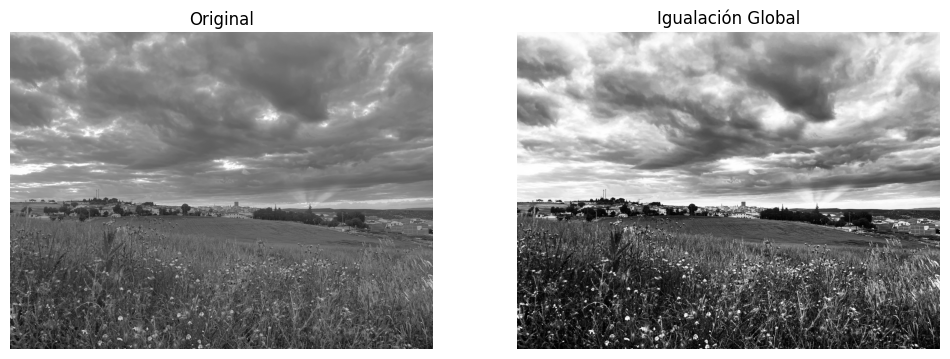

In [21]:
equ = cv2.equalizeHist(img_gray)
comparar(img_gray, equ, "Igualación Global", es_gris=True)

## 2. Igualación Adaptativa (CLAHE)
Evita la amplificación excesiva del ruido procesando por bloques.

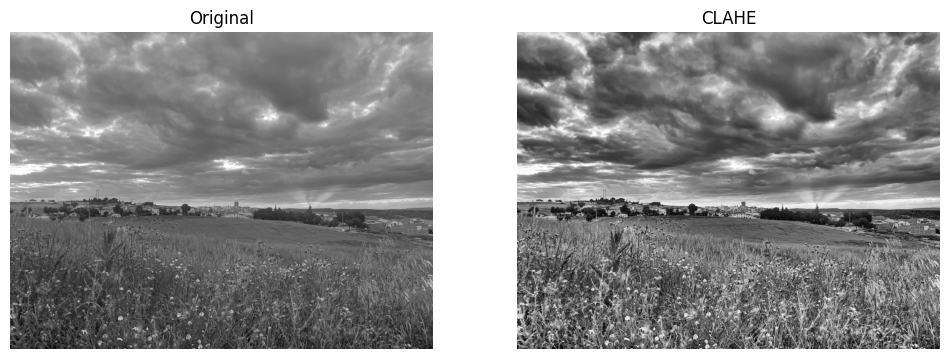

In [7]:
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
img_clahe = clahe.apply(img_gray)
comparar(img_gray, img_clahe, "CLAHE", es_gris=True)

## 3. Igualación en Color (Espacio HSV)
Igualamos el canal 'V' para no distorsionar los colores.

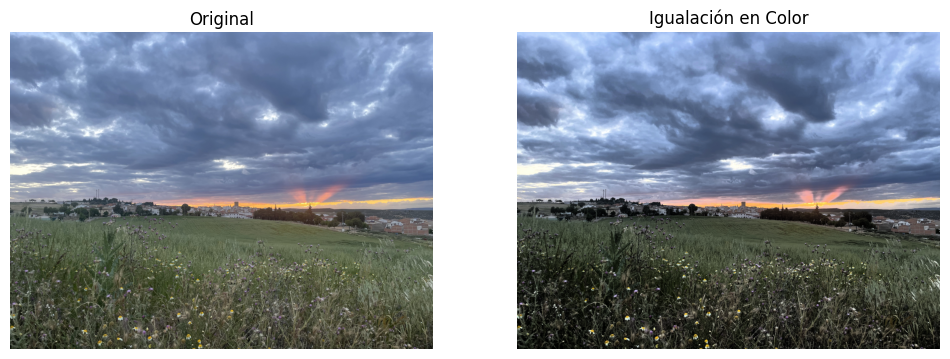

In [8]:
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
hsv[:,:,2] = cv2.equalizeHist(hsv[:,:,2])
res_color = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
comparar(img, res_color, "Igualación en Color")

## 4. Filtro de Identidad
Uso de `filter2D` con un kernel que no modifica la imagen.

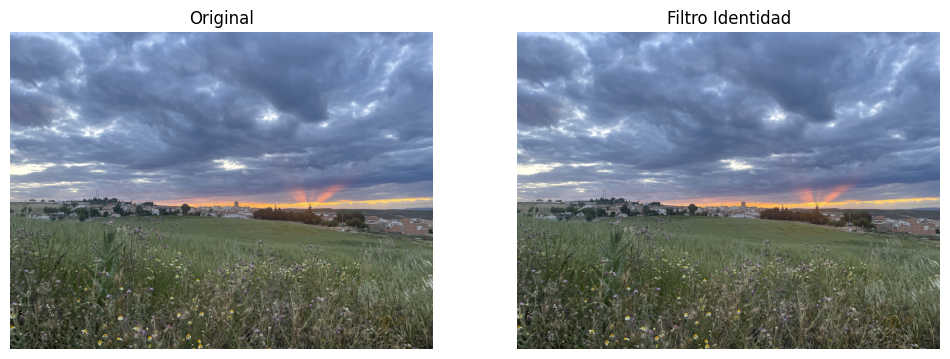

In [9]:
kernel = np.array([[0, 0, 0], [0, 1, 0], [0, 0, 0]])
identidad = cv2.filter2D(img, -1, kernel)
comparar(img, identidad, "Filtro Identidad")

## 5. Filtro de Media (Box Blur)
Suavizado uniforme.

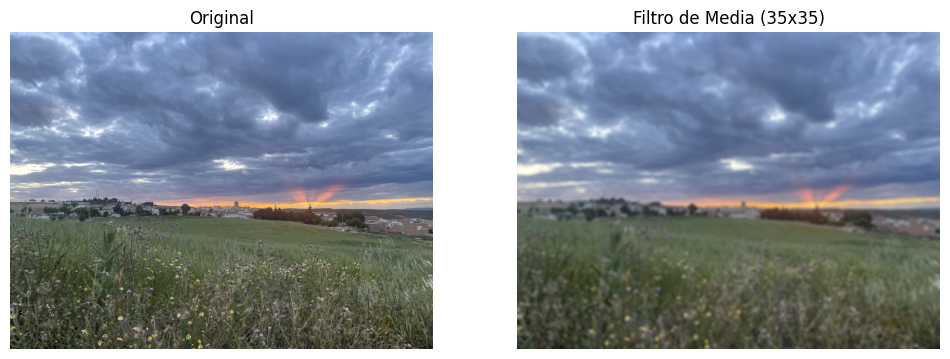

In [11]:
blur = cv2.blur(img, (35, 35))
comparar(img, blur, "Filtro de Media (35x35)")

## 6. Filtro Gaussiano
Suavizado preservando mejor las estructuras.

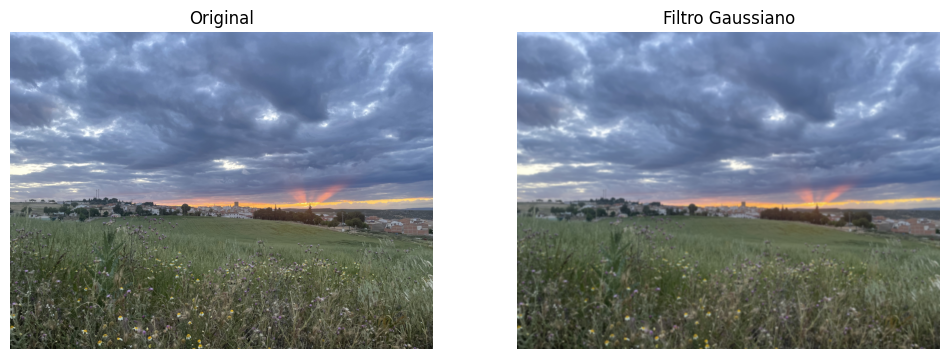

In [12]:
gauss = cv2.GaussianBlur(img, (35, 35), 0)
comparar(img, gauss, "Filtro Gaussiano")

## 7. Filtro de Afilado (Sharpening)
Realce de detalles.

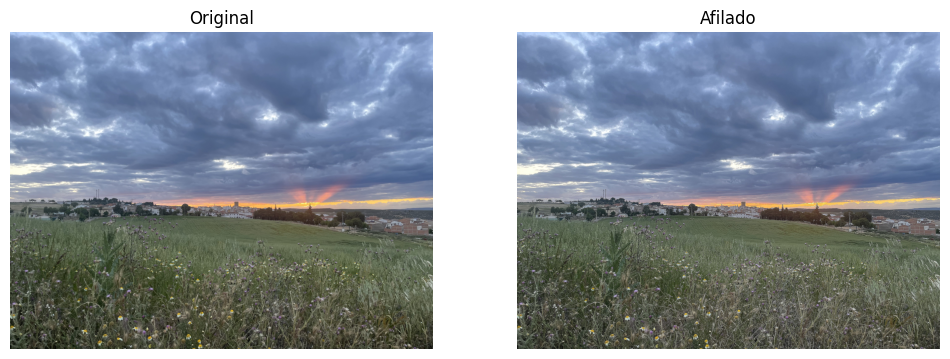

In [13]:
k_sharp = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
sharp = cv2.filter2D(img, -1, k_sharp)
comparar(img, sharp, "Afilado")

## 8. Operador Sobel
Detección de bordes (Gradientes).

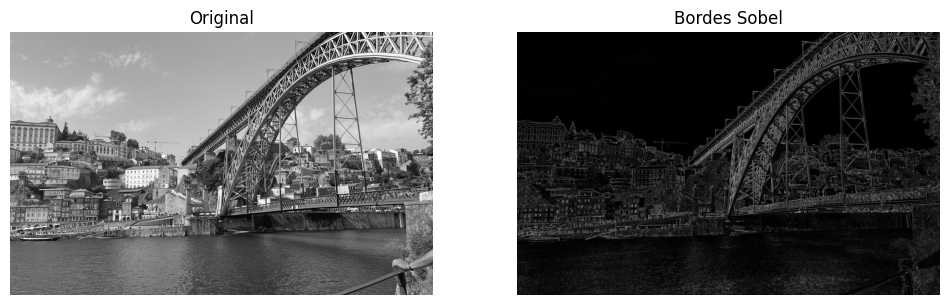

In [4]:
sobelx = cv2.Sobel(img2, cv2.CV_64F, 1, 0, ksize=3)
sobely = cv2.Sobel(img2, cv2.CV_64F, 0, 1, ksize=3)
sobel = cv2.magnitude(sobelx, sobely)
comparar(img2, sobel, "Bordes Sobel", es_gris=True)

## 9. Filtro de Relieve (Emboss)
Efecto 3D.

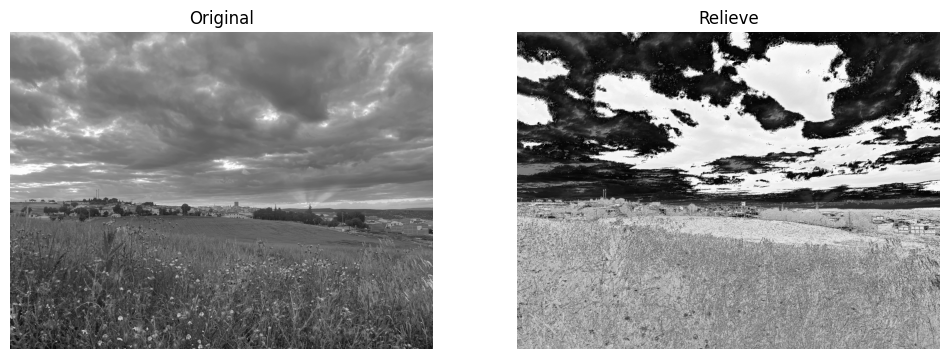

In [5]:
k_emboss = np.array([[-2,-1,0], [-1,1,1], [0,1,2]])
emboss = cv2.filter2D(img_gray, -1, k_emboss) + 128
comparar(img_gray, emboss, "Relieve", es_gris=True)

## 10. Filtro Bilateral
Suavizado sin emborronar bordes.

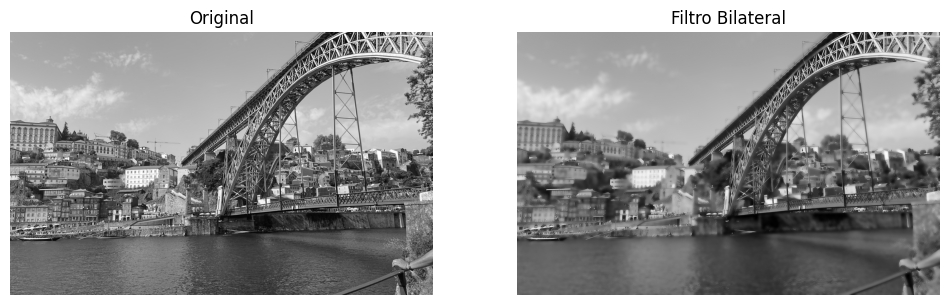

In [6]:
bilateral = cv2.bilateralFilter(img2, 35, 75, 75)
comparar(img2, bilateral, "Filtro Bilateral")

## 11. Filtro de Mediana
Ideal para ruido 'Sal y Pimienta'.

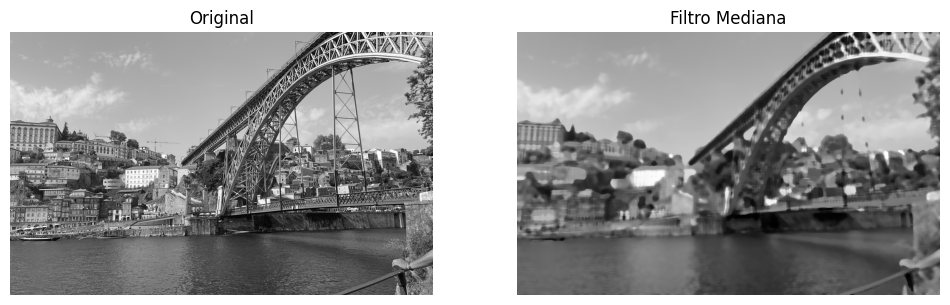

In [7]:
mediana = cv2.medianBlur(img2, 35)
comparar(img2, mediana, "Filtro Mediana")

## 12. Operador Laplaciano
Segunda derivada para bordes.

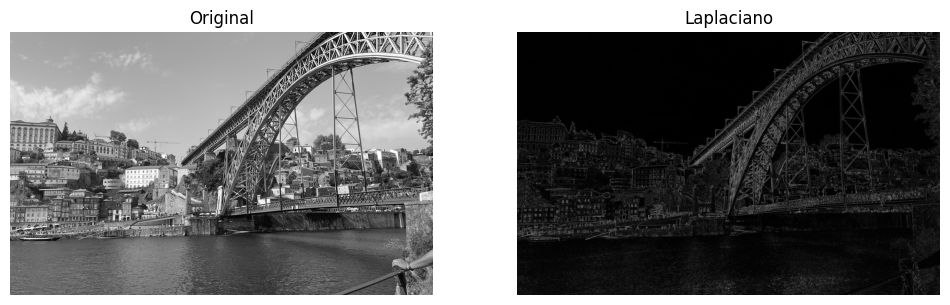

In [8]:
lap = cv2.Laplacian(img2, cv2.CV_64F)
lap = np.uint8(np.absolute(lap))
comparar(img2, lap, "Laplaciano", es_gris=True)

## 13. Motion Blur
Efecto de movimiento.

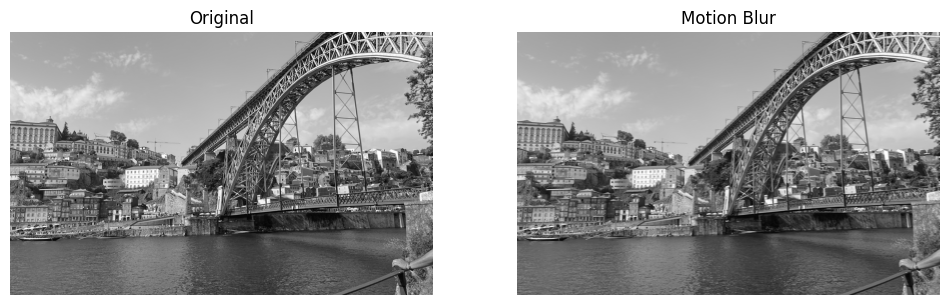

In [13]:
size = 15
k_motion = np.zeros((size, size))
k_motion[int((size-1)/2), :] = np.ones(size)
k_motion = k_motion / size
m_blur = cv2.filter2D(img2, -1, k_motion)
comparar(img2, m_blur, "Motion Blur")

## 14. Unsharp Masking
Realce de bordes mediante sustracción.

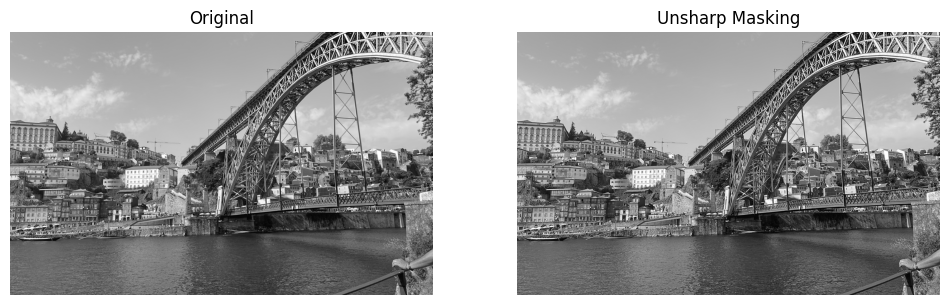

In [10]:
gauss_u = cv2.GaussianBlur(img2, (9,9), 10.0)
unsharp = cv2.addWeighted(img2, 1.5, gauss_u, -0.5, 0)
comparar(img2, unsharp, "Unsharp Masking")

## 15. Operador de Prewitt
Alternativa a Sobel.

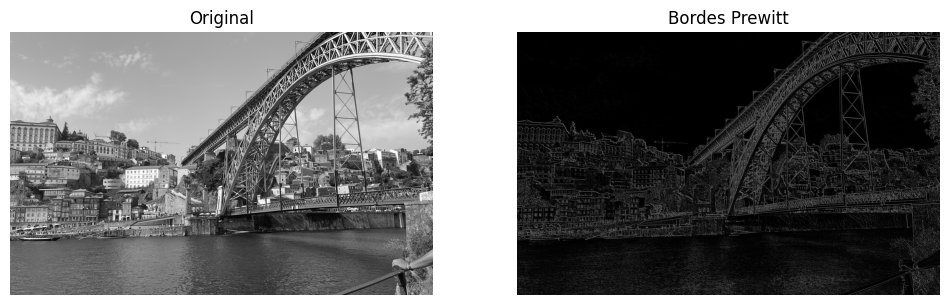

In [11]:
kx = np.array([[1,1,1],[0,0,0],[-1,-1,-1]])
ky = np.array([[-1,0,1],[-1,0,1],[-1,0,1]])
px = cv2.filter2D(img2, -1, kx)
py = cv2.filter2D(img2, -1, ky)
prewitt = cv2.addWeighted(px, 0.5, py, 0.5, 0)
comparar(img2, prewitt, "Bordes Prewitt", es_gris=True)

# Tema5: Procesamiento en el dominio frecuencial

En este capítulo analizaremos las imágenes desde su composición frecuencial mediante la **Transformada Rápida de Fourier (FFT)**. 

Aprenderemos a descomponer una imagen en:
* **Bajas frecuencias**: Formas suaves, iluminación global.
* **Altas frecuencias**: Bordes, detalles finos y ruido.

Utilizaremos filtros en el plano complejo para restaurar y mejorar imágenes de formas que serían imposibles en el dominio espacial.

In [22]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def mostrar_frecuencia(img, espectro, resultado, titulo_res="Resultado"):
    plt.figure(figsize=(15, 5))
    
    plt.subplot(131); plt.imshow(img, cmap='gray')
    plt.title("Original"); plt.axis('off')
    
    plt.subplot(132); plt.imshow(espectro, cmap='gray')
    plt.title("Espectro Magnitud (log)"); plt.axis('off')
    
    plt.subplot(133); plt.imshow(resultado, cmap='gray')
    plt.title(titulo_res); plt.axis('off')
    
    plt.show()

img = cv2.imread('imagen.jpg', 0)
img2 = cv2.imread('imagenbordes.jpg', 0)
if img is None:
    img = np.zeros((300, 300), dtype="uint8")
    cv2.putText(img, 'FALTA imagen.jpg', (20, 150), cv2.FONT_HERSHEY_SIMPLEX, 1, 255, 2)

## 1 y 2. Magnitud y Fase del espectro
Calculamos la FFT y visualizamos sus componentes.

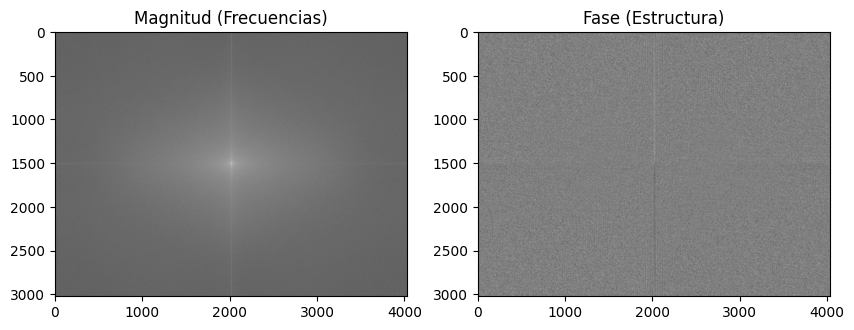

In [15]:
f = np.fft.fft2(img)
fshift = np.fft.fftshift(f)
magnitud = 20 * np.log(np.abs(fshift) + 1)
fase = np.angle(fshift)

plt.figure(figsize=(10, 5))
plt.subplot(121); plt.imshow(magnitud, cmap='gray'); plt.title('Magnitud (Frecuencias)')
plt.subplot(122); plt.imshow(fase, cmap='gray'); plt.title('Fase (Estructura)')
plt.show()

## 3. Reconstrucción IFFT
Verificamos que la transformada es reversible.

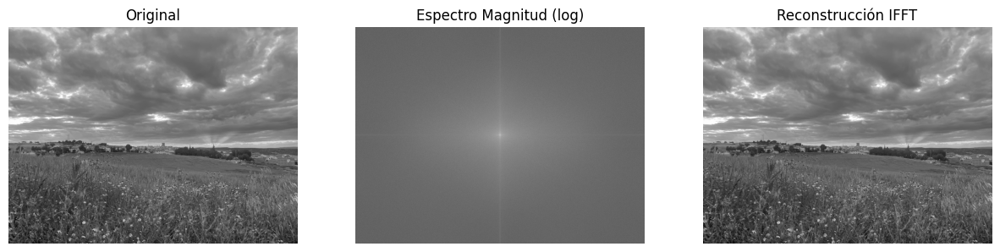

In [16]:
f_ishift = np.fft.ifftshift(fshift)
img_back = np.abs(np.fft.ifft2(f_ishift))
mostrar_frecuencia(img, magnitud, img_back, "Reconstrucción IFFT")

## 4. Filtros Ideales (Bajo)
Corte abrupto de frecuencias.

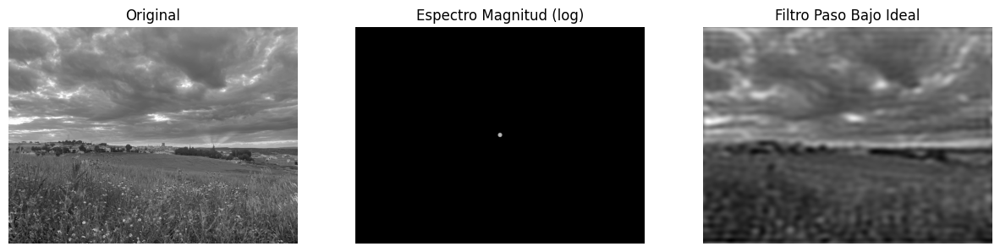

In [17]:
rows, cols = img.shape
crow, ccol = rows//2, cols//2
D0 = 30

# Máscara Paso Bajo Ideal
mask_low = np.zeros((rows, cols), np.uint8)
cv2.circle(mask_low, (ccol, crow), D0, 1, -1)

res_low = np.abs(np.fft.ifft2(np.fft.ifftshift(fshift * mask_low)))
mostrar_frecuencia(img, 20*np.log(np.abs(fshift*mask_low)+1), res_low, "Filtro Paso Bajo Ideal")

## 5. Filtros Ideales (Alto)
Corte abrupto de frecuencias.

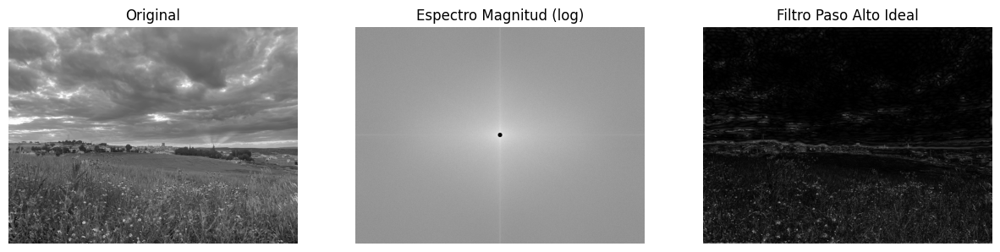

In [25]:
rows, cols = img.shape
crow, ccol = rows//2, cols//2
D0 = 30

f = np.fft.fft2(img)
fshift = np.fft.fftshift(f)

# Máscara Paso Alto Ideal
mask = np.ones((rows, cols), np.uint8)
cv2.circle(mask, (ccol, crow), D0, 0, -1)

res = np.abs(np.fft.ifft2(np.fft.ifftshift(fshift * mask)))
mostrar_frecuencia(img, 20*np.log(np.abs(fshift*mask)+1), res, "Filtro Paso Alto Ideal")

## 6 Filtros Butterworth Bajo
Transición suave controlada por el orden $n$.

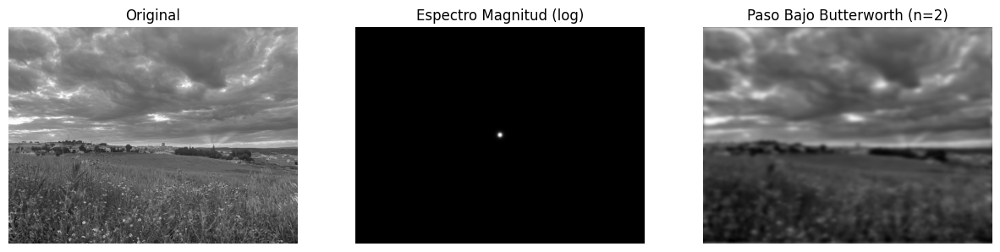

In [36]:
x, y = np.meshgrid(np.linspace(-cols/2, cols/2, cols), np.linspace(-rows/2, rows/2, rows))
D = np.sqrt(x**2 + y**2)
D0, n = 30, 2
mask_btw = 1 / (1 + (D/D0)**(2*n))

res_btw = np.abs(np.fft.ifft2(np.fft.ifftshift(fshift * mask_btw)))
mostrar_frecuencia(img, mask_btw, res_btw, "Paso Bajo Butterworth (n=2)")

## 7 Filtros Butterworth Alto
Transición suave controlada por el orden $n$.

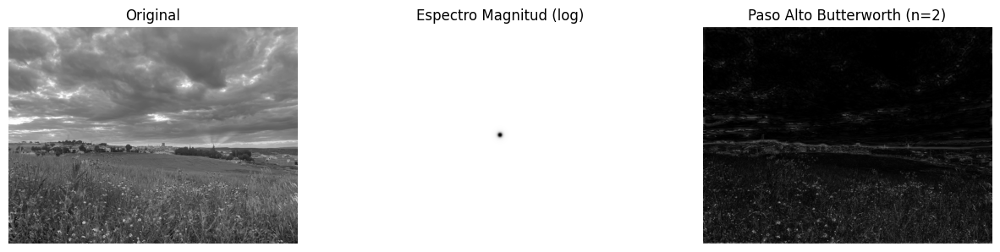

In [28]:
x, y = np.meshgrid(np.linspace(-cols/2, cols/2, cols), np.linspace(-rows/2, rows/2, rows))
D = np.sqrt(x**2 + y**2)
D0, n = 30, 2
mask = 1 / (1 + (D0 / (D + 1e-5))**(2*n))

f = np.fft.fft2(img)
fshift = np.fft.fftshift(f)
f_filtrado = fshift * mask

img_back = np.abs(np.fft.ifft2(np.fft.ifftshift(f_filtrado)))

mostrar_frecuencia(img, mask, img_back, "Paso Alto Butterworth (n=2)")

## 8. Filtros Gaussianos. Paso Bajo

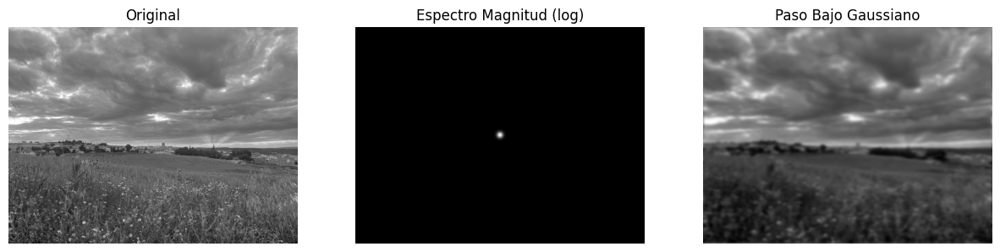

In [37]:
mask_gauss = np.exp(-(D**2) / (2 * (D0**2)))
res_gauss = np.abs(np.fft.ifft2(np.fft.ifftshift(fshift * mask_gauss)))
mostrar_frecuencia(img, mask_gauss, res_gauss, "Paso Bajo Gaussiano")

## 9. Filtros Gaussianos. Paso Alto

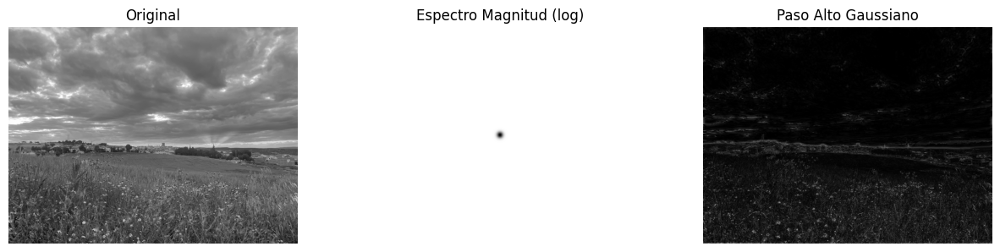

In [29]:
# La fórmula cambia de exp(-D^2/2D0^2) a 1 - exp(-D^2/2D0^2)
mask_gauss = 1 - np.exp(-(D**2) / (2 * (D0**2)))

res_gauss = np.abs(np.fft.ifft2(np.fft.ifftshift(fshift * mask_gauss)))

mostrar_frecuencia(img, mask_gauss, res_gauss, "Paso Alto Gaussiano")

## 10. Filtro de Muesca (Notch)
Elimina ruido periódico eliminando picos específicos en el espectro.

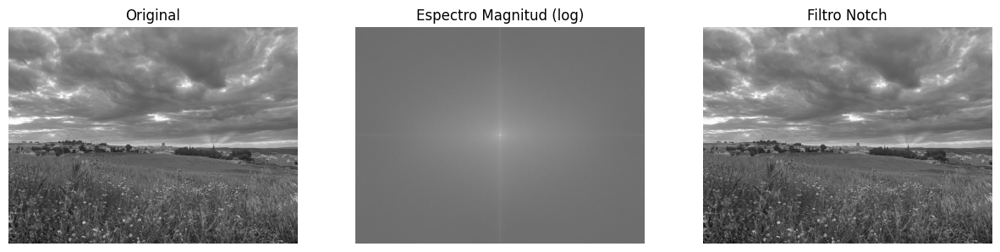

In [38]:
f_notch = fshift.copy()
# Simulamos la anulación de un ruido en coordenadas específicas
f_notch[crow-20:crow-15, ccol-20:ccol-15] = 0
f_notch[crow+15:crow+20, ccol+15:ccol+20] = 0
res_notch = np.abs(np.fft.ifft2(np.fft.ifftshift(f_notch)))
mostrar_frecuencia(img, 20*np.log(np.abs(f_notch)+1), res_notch, "Filtro Notch")

## 11. Filtros de Banda Rechazo(Reject)

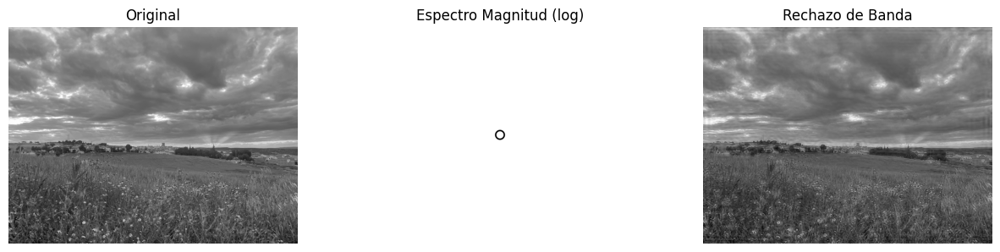

In [39]:
D0, W = 60, 20
mask_reject = np.logical_or(D < (D0-W/2), D > (D0+W/2))
res_reject = np.abs(np.fft.ifft2(np.fft.ifftshift(fshift * mask_reject)))
mostrar_frecuencia(img, mask_reject, res_reject, "Rechazo de Banda")

## 12. Filtros de Paso de Banda (Pass)

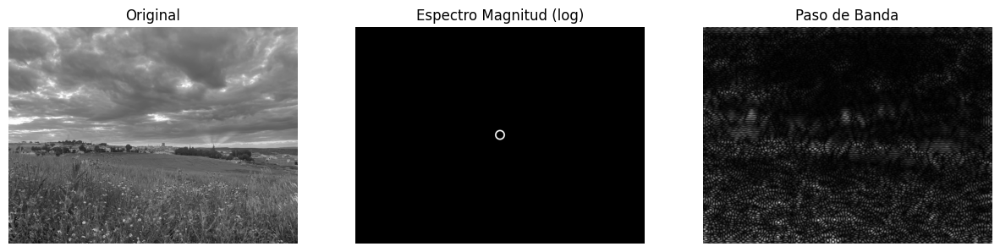

In [30]:
D0, W = 60, 20

mask_pass = np.logical_and(D >= (D0 - W/2), D <= (D0 + W/2))

res_pass = np.abs(np.fft.ifft2(np.fft.ifftshift(fshift * mask_pass)))

mostrar_frecuencia(img, mask_pass, res_pass, "Paso de Banda")

## 13. Filtrado Homomórfico
Tratamiento logarítmico para corregir iluminación.

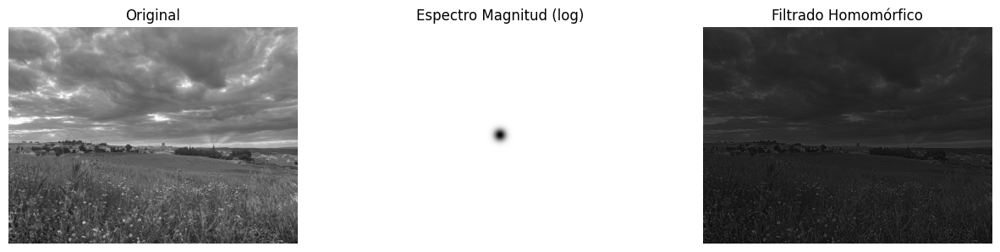

In [32]:
x, y = np.meshgrid(np.linspace(-cols/2, cols/2, cols), np.linspace(-rows/2, rows/2, rows))
D = np.sqrt(x**2 + y**2) 


# Parámetros más suaves para evitar el "negro"
Rh, Rl, c, D0_h = 1.5, 0.7, 1.0, 80 

# Aplicar máscara
mask_hom = (Rh - Rl) * (1 - np.exp(-c * (D**2 / D0_h**2))) + Rl
res_ifft = np.fft.ifft2(np.fft.ifftshift(f_log * mask_hom))

# RECONSTRUCCIÓN CRÍTICA
res_hom = np.expm1(np.real(res_ifft)) # Usar siempre np.real

# Normalizar con cuidado
res_hom = cv2.normalize(res_hom, None, 0, 255, cv2.NORM_MINMAX)
res_final = np.uint8(np.clip(res_hom, 0, 255))
mostrar_frecuencia(img, mask_hom, res_final, "Filtrado Homomórfico")



## 14. Énfasis de Alta Frecuencia
Combina el paso alto con una constante para no perder el fondo.

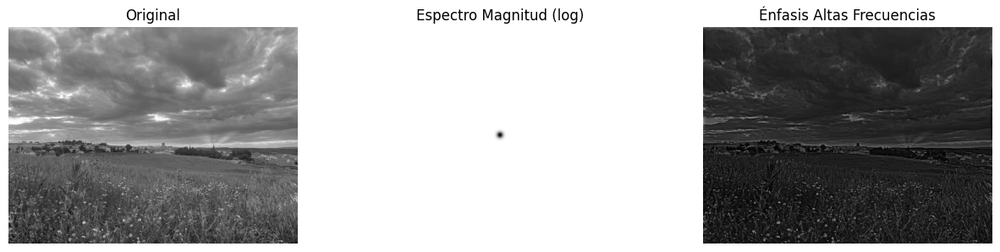

In [41]:
mask_hp = 1 - mask_gauss
mask_emph = 0.5 + 1.5 * mask_hp
res_emph = np.abs(np.fft.ifft2(np.fft.ifftshift(fshift * mask_emph)))
mostrar_frecuencia(img, mask_emph, np.uint8(cv2.normalize(res_emph, None, 0, 255, cv2.NORM_MINMAX)), "Énfasis Altas Frecuencias")

## 15. Importancia de la Fase frente a la Magnitud
Intercambio de fase y magnitud entre dos imágenes.

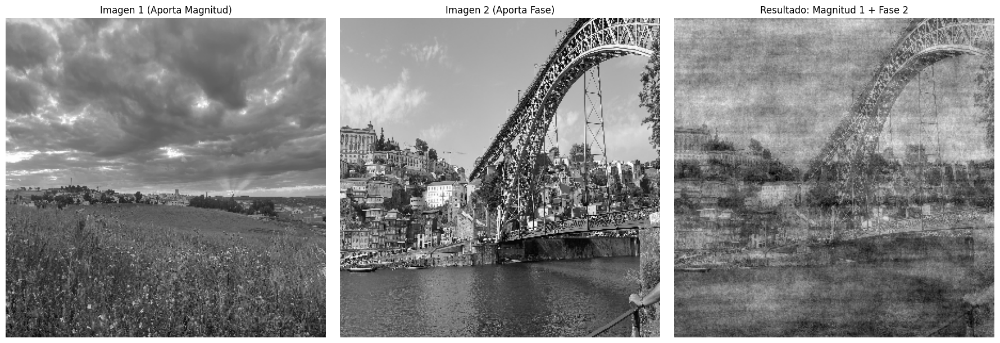

In [37]:

# Ambas deben tener el mismo tamaño para que sus espectros coincidan
img1 = cv2.resize(cv2.imread('imagen.jpg', 0), (300, 300))
img2 = cv2.resize(cv2.imread('imagenbordes.jpg', 0), (300, 300))

# Calcular la FFT de ambas
f1 = np.fft.fft2(img1)
f2 = np.fft.fft2(img2)

# Combinar: Magnitud de img1 + Fase de img2
# La fase (angle) determina dónde se colocan los componentes (la estructura)
combined = np.multiply(np.abs(f1), np.exp(1j * np.angle(f2)))

# Reconstruir (IFFT)
# Usamos np.abs para obtener la intensidad final de los números complejos
res = np.abs(np.fft.ifft2(combined))

# Normalizar el resultado para que se vea correctamente (0-255)
res_final = cv2.normalize(res, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

# Visualización de 3 paneles
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))

ax1.imshow(img1, cmap='gray')
ax1.set_title('Imagen 1 (Aporta Magnitud)')
ax1.axis('off')

ax2.imshow(img2, cmap='gray')
ax2.set_title('Imagen 2 (Aporta Fase)')
ax2.axis('off')

ax3.imshow(res_final, cmap='gray')
ax3.set_title('Resultado: Magnitud 1 + Fase 2')
ax3.axis('off')

plt.tight_layout()
plt.show()


# Tema 6: Umbralización global y local de imágenes

En este capítulo abordaremos la **umbralización**, técnica crítica para la segmentación. El objetivo es convertir imágenes en escala de grises a binarias (blanco y negro) para extraer objetos de interés.

Exploraremos:
* **Umbralización Global**: Manual y automática (Otsu, Triángulo).
* **Umbralización Local/Adaptativa**: Para corregir problemas de iluminación no uniforme.
* **Algoritmos avanzados**: Niblack y Sauvola para documentos degradados.

In [42]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import filters # Para Niblack y Sauvola (pip install scikit-image)

def mostrar_binarizacion(original, binaria, titulo="Resultado"):
    plt.figure(figsize=(12, 5))
    
    plt.subplot(121)
    plt.imshow(original, cmap='gray')
    plt.title("Original (Gris)"); plt.axis('off')
    
    plt.subplot(122)
    plt.imshow(binaria, cmap='gray')
    plt.title(titulo); plt.axis('off')
    
    plt.show()

img_gris = cv2.imread('imagen.jpg', 0)
if img_gris is None:
    img_gris = np.zeros((300, 300), dtype="uint8")
    cv2.putText(img_gris, 'FALTA imagen.jpg', (20, 150), cv2.FONT_HERSHEY_SIMPLEX, 0.8, 255, 2)

## 1 a 4. Tipos de Umbralización Global (Manual)
Aplicamos un umbral fijo $T=127$ con diferentes banderas.

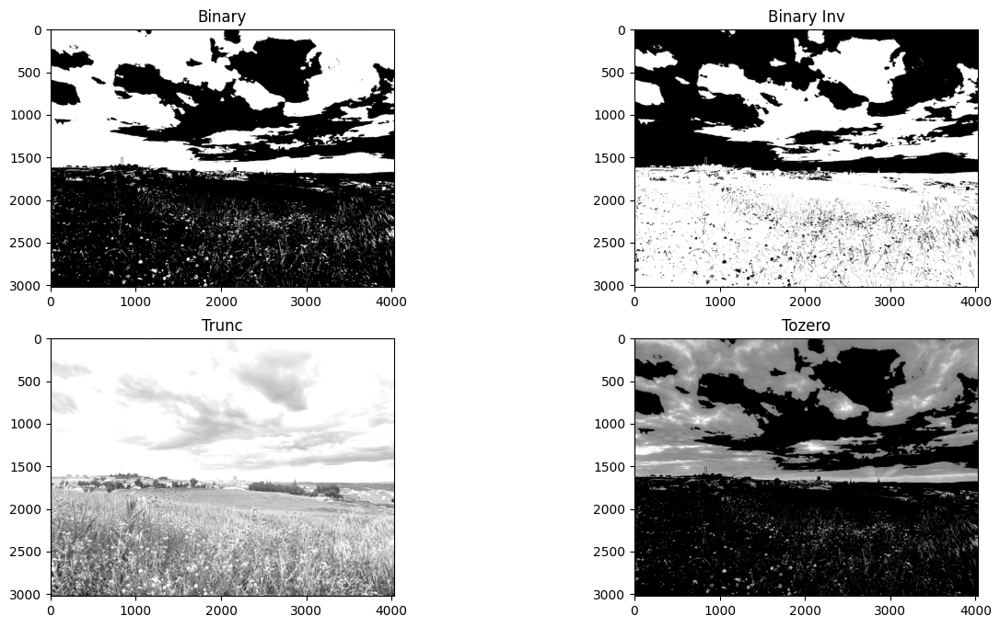

In [43]:
T = 127
_, t_simple = cv2.threshold(img_gris, T, 255, cv2.THRESH_BINARY)
_, t_inv = cv2.threshold(img_gris, T, 255, cv2.THRESH_BINARY_INV)
_, t_trunc = cv2.threshold(img_gris, T, 255, cv2.THRESH_TRUNC)
_, t_tozero = cv2.threshold(img_gris, T, 255, cv2.THRESH_TOZERO)

plt.figure(figsize=(15, 8))
plt.subplot(221); plt.imshow(t_simple, cmap='gray'); plt.title('Binary')
plt.subplot(222); plt.imshow(t_inv, cmap='gray'); plt.title('Binary Inv')
plt.subplot(223); plt.imshow(t_trunc, cmap='gray'); plt.title('Trunc')
plt.subplot(224); plt.imshow(t_tozero, cmap='gray'); plt.title('Tozero')
plt.show()

## 5. Binarización Automática de Otsu
Minimiza la varianza intraclase para encontrar el umbral óptimo.

Umbral calculado por Otsu: 110.0


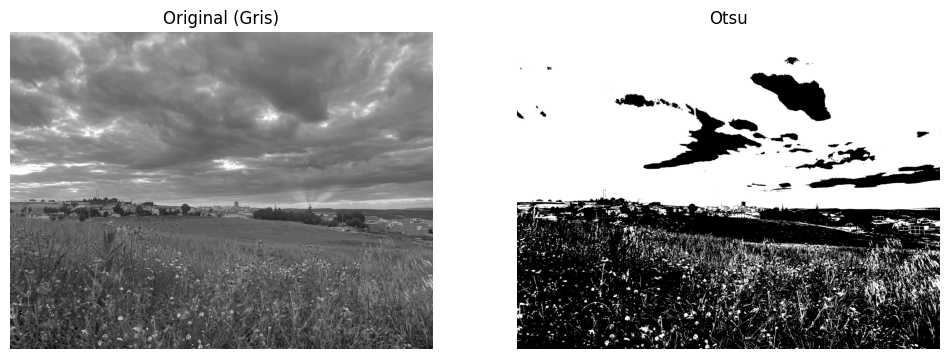

In [44]:
val_otsu, t_otsu = cv2.threshold(img_gris, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
print(f"Umbral calculado por Otsu: {val_otsu}")
mostrar_binarizacion(img_gris, t_otsu, "Otsu")

## 6.  Umbralización Adaptativa por media (Local)
Calcula un umbral distinto para cada vecindad de píxeles.

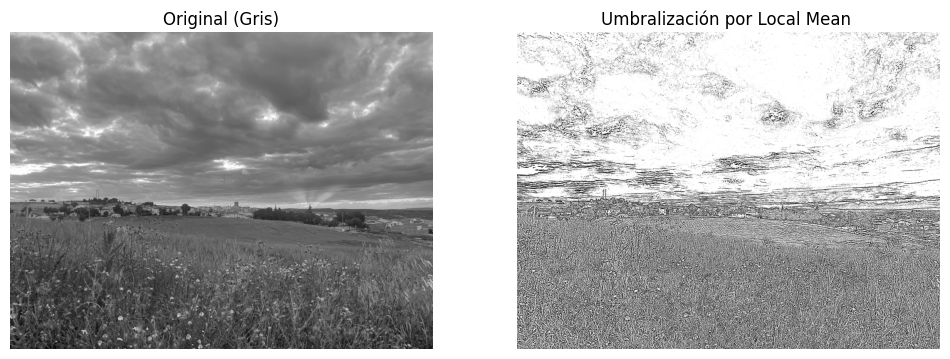

In [53]:
img = cv2.imread('imagen.jpg',0)
t_adapt_mean = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)

mostrar_binarizacion(img,t_adapt_mean, "Umbralización por Local Mean ")

## 7. Umbralización Adaptativa Gaussiana (Local)
Calcula un umbral distinto para cada vecindad de píxeles.

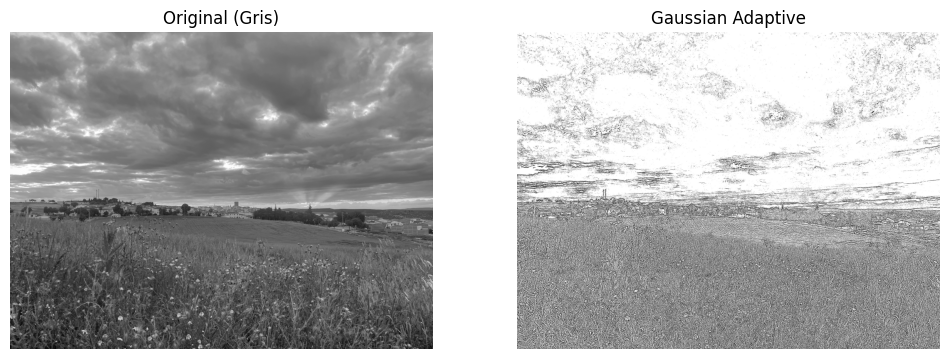

In [51]:
t_adapt_gauss = cv2.adaptiveThreshold(img_gris, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)
mostrar_binarizacion(img, t_adapt_gauss, "Gaussian Adaptive")

## 8. Otsu tras suavizado Gaussiano
Mejoramos la robustez del umbral automático eliminando ruido.

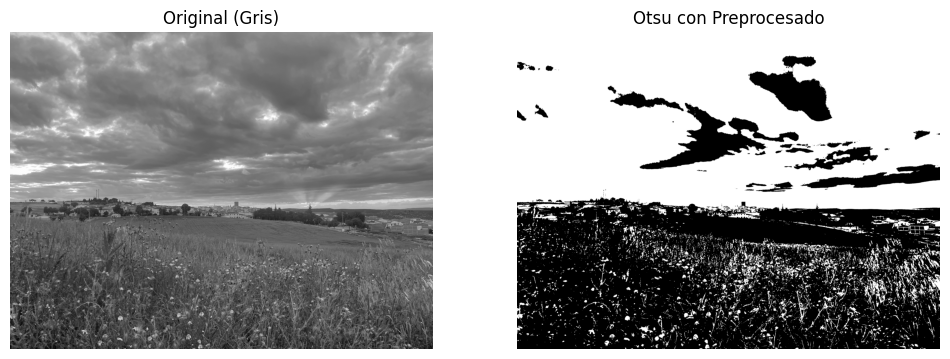

In [47]:
blur = cv2.GaussianBlur(img_gris, (5, 5), 0)
_, t_otsu_blur = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
mostrar_binarizacion(img_gris, t_otsu_blur, "Otsu con Preprocesado")

## 9. Método del Triángulo
Eficaz para histogramas con un pico dominante.

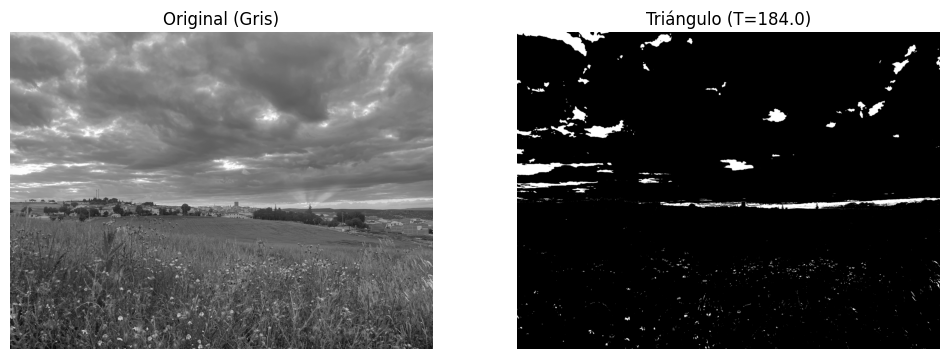

In [48]:
val_tri, t_tri = cv2.threshold(img_gris, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_TRIANGLE)
mostrar_binarizacion(img_gris, t_tri, f"Triángulo (T={val_tri})")

## 10. Umbralización Multinivel
Separación en 3 niveles de gris (Segmentación tonal).

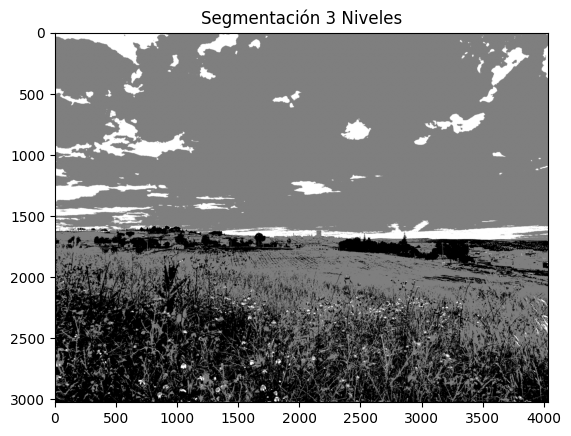

In [49]:
multinivel = np.zeros_like(img_gris)
multinivel[img_gris > 85] = 127
multinivel[img_gris > 170] = 255
plt.imshow(multinivel, cmap='gray'); plt.title("Segmentación 3 Niveles"); plt.show()

## 11. Segmentación por Color (HSV)
Umbralización aplicada a canales de color.

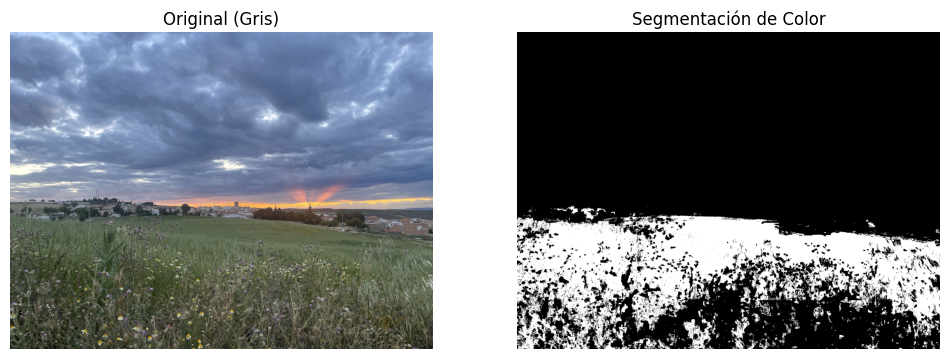

In [50]:
img_color = cv2.imread('imagen.jpg')
hsv = cv2.cvtColor(img_color, cv2.COLOR_BGR2HSV)
# Ejemplo: Segmentar verdes
bajo = np.array([35, 40, 40])
alto = np.array([85, 255, 255])
mascara = cv2.inRange(hsv, bajo, alto)
mostrar_binarizacion(cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB), mascara, "Segmentación de Color")

## 12 y 13. Niblack y Sauvola
Métodos locales avanzados para OCR y documentos.

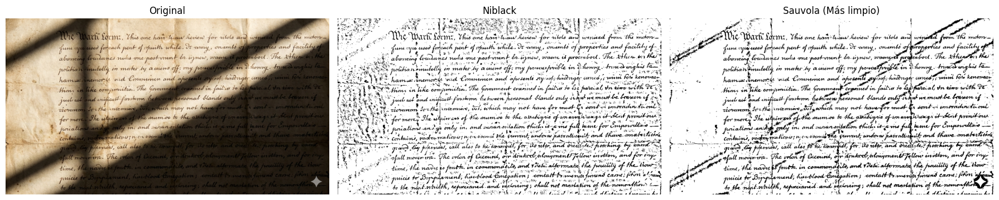

In [57]:

img_tex = cv2.imread('imagentexto.png')
# 2. CONVERTIR A GRIS (Obligatorio para que Sauvola/Niblack funcionen)
img_gray = cv2.cvtColor(img_tex, cv2.COLOR_BGR2GRAY)

# 3. Calcular umbrales usando la imagen gris CORRECTA
t_niblack = filters.threshold_niblack(img_gray, window_size=25, k=0.8)
t_sauvola = filters.threshold_sauvola(img_gray, window_size=25)

# 4. Binarizar usando la misma imagen (evita el error de 'broadcast')
bin_niblack = (img_gray > t_niblack).astype(np.uint8) * 255
bin_sauvola = (img_gray > t_sauvola).astype(np.uint8) * 255

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 7))
    
ax1.imshow(cv2.cvtColor(img_tex, cv2.COLOR_BGR2RGB))
ax1.set_title("Original")
ax1.axis('off')
    
ax2.imshow(bin_niblack, cmap='gray')
ax2.set_title("Niblack")
ax2.axis('off')
    
ax3.imshow(bin_sauvola, cmap='gray')
ax3.set_title("Sauvola (Más limpio)")
ax3.axis('off')
    
plt.tight_layout()
plt.show()

## 14. Umbralización Local por Bloques (Manual)

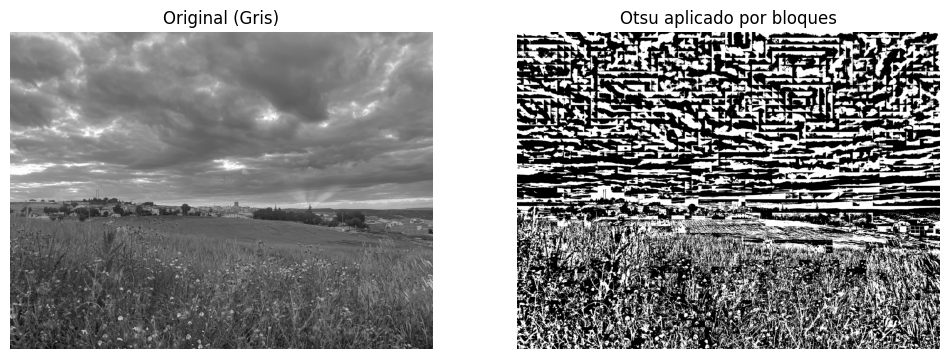

In [52]:
h, w = img_gris.shape
res_bloques = np.zeros_like(img_gris)
tam_bloque = 64
for i in range(0, h, tam_bloque):
    for j in range(0, w, tam_bloque):
        roi = img_gris[i:i+tam_bloque, j:j+tam_bloque]
        _, t = cv2.threshold(roi, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        res_bloques[i:i+tam_bloque, j:j+tam_bloque] = t
mostrar_binarizacion(img_gris, res_bloques, "Otsu aplicado por bloques")

## 15. Comparativa final: Global vs Adaptativo

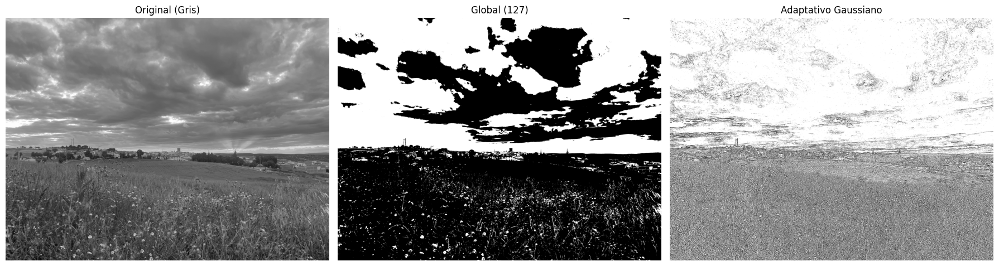

In [58]:

    img = cv2.imread('imagen.jpg', 0)

    # Umbral Global Simple (valor fijo de 127)
    _, t1 = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)

    # Umbral Adaptativo Gaussiano
    # Calcula el umbral para áreas pequeñas de 11x11 píxeles.
    t2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                 cv2.THRESH_BINARY, 11, 2)

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))

    ax1.imshow(img, cmap='gray')
    ax1.set_title('Original (Gris)')
    ax1.axis('off')


    ax2.imshow(t1, cmap='gray')
    ax2.set_title('Global (127)')
    ax2.axis('off')


    ax3.imshow(t2, cmap='gray')
    ax3.set_title('Adaptativo Gaussiano')
    ax3.axis('off')

    plt.tight_layout()
    plt.show()


# Tema 7: Detección de objetos mediante cascadas de Haar

En este capítulo exploraremos la detección de objetos basada en clasificadores de cascada. Esta técnica utiliza características de Haar, que analizan las diferencias de intensidad en regiones adyacentes de la imagen, junto con una estructura de clasificadores en cascada para descartar rápidamente las regiones de la imagen que no contienen el objeto buscado.

A través de estos ejercicios, aprenderemos a configurar los parámetros críticos del método `detectMultiScale`, como el factor de escala y el número mínimo de vecinos. 

**Nota Previa:** Los clasificadores de Haar requieren imágenes con los objetos específicos (rostros, cuerpos, etc.). Asegúrate de tener una imagen llamada `personas.jpg` en tu carpeta.

In [59]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def mostrar_deteccion(img, titulo="Detección"):
    plt.figure(figsize=(10, 6))
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    plt.title(titulo); plt.axis('off')
    plt.show()

# Cargamos la ruta de los XML oficiales de OpenCV
path = cv2.data.haarcascades
face_cas = cv2.CascadeClassifier(path + 'haarcascade_frontalface_default.xml')

img = cv2.imread('personas.png')
if img is None:
    img = np.zeros((400, 600, 3), dtype="uint8")
    cv2.putText(img, 'FALTA personas.jpg', (50, 200), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), 2)

## 1. Detección básica de rostros frontales
Utilizaremos el clasificador estándar de OpenCV para identificar rostros frontales y dibujar cuadros delimitadores (*bounding boxes*).

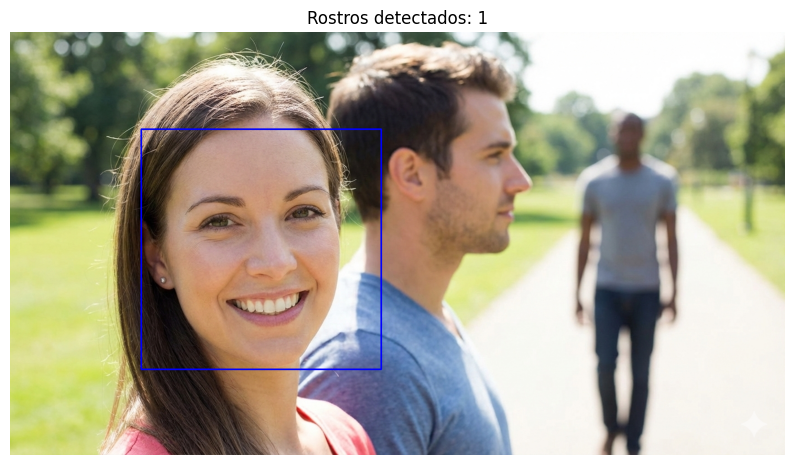

In [58]:
img_1 = img.copy()
gray = cv2.cvtColor(img_1, cv2.COLOR_BGR2GRAY)
faces = face_cas.detectMultiScale(gray, 1.3, 5)
for (x,y,w,h) in faces:
    cv2.rectangle(img_1, (x,y), (x+w,y+h), (255,0,0), 2)
mostrar_deteccion(img_1, f"Rostros detectados: {len(faces)}")

## 2. Ajuste del parámetro scaleFactor
Este parámetro compensa la distancia a la cámara. Un valor de 1.1 es más lento pero detecta más tamaños de rostro que un valor de 1.5.

In [59]:
faces_sf = face_cas.detectMultiScale(gray, scaleFactor=1.05, minNeighbors=5)
print(f"Detecciones con scaleFactor bajo: {len(faces_sf)}")

Detecciones con scaleFactor bajo: 1


## 3. Ajuste de minNeighbors
Define cuántos vecinos debe tener un candidato para ser aceptado. Valores altos eliminan falsos positivos en el fondo.

In [60]:
faces_mn = face_cas.detectMultiScale(gray, 1.3, minNeighbors=10)
print(f"Detecciones con minNeighbors alto: {len(faces_mn)}")

Detecciones con minNeighbors alto: 1


## 4. Detección de ojos dentro de un rostro (ROI)
Optimizamos la búsqueda limitando el detector de ojos únicamente a la región donde se ha encontrado un rostro.

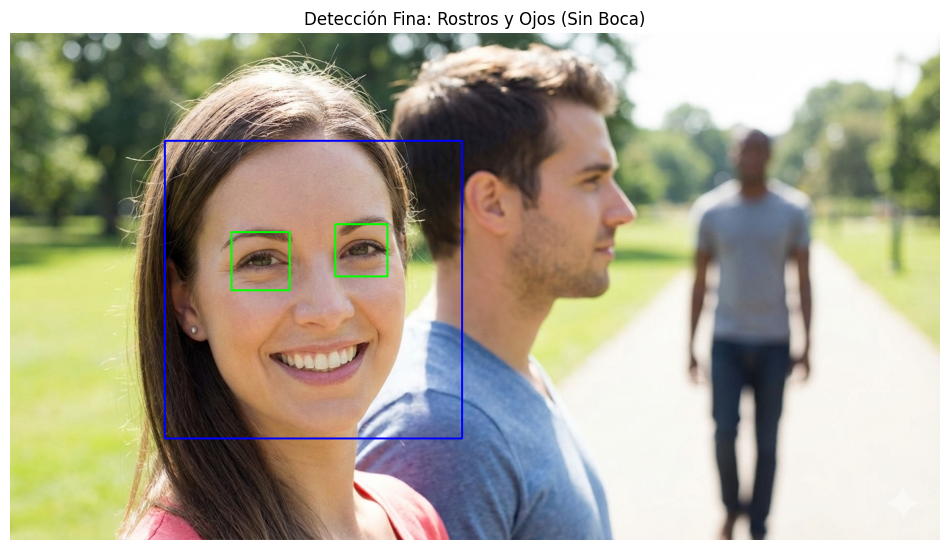

In [60]:
face_cas = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
eye_cas = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_eye.xml')

img = cv2.imread('personas.png')
if img is None:
    print("Error: No se pudo cargar la imagen.")
else:
    # Convertir a gris para el procesamiento
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img_out = img.copy()

    # Detectar Rostros
    faces = face_cas.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5, minSize=(100, 100))

    for (x, y, w, h) in faces:
        # Dibujar rectángulo en el rostro (Azul)
        cv2.rectangle(img_out, (x, y), (x+w, y+h), (255, 0, 0), 2)
        
        # Definir las Regiones de Interés (ROI)
        roi_gray = gray[y:y+h, x:x+w]
        roi_color = img_out[y:y+h, x:x+w]
        
        # RESTRICCIÓN PARA EVITAR LA BOCA 
        # Cortamos el ROI de la cara para que solo busque en el 60% superior
        alto_ojos = int(h * 0.6)
        zona_ojos_gray = roi_gray[0:alto_ojos, :]
        
        #  Detectar Ojos en la zona restringida
        # minNeighbors=10 es lo bastante estricto para evitar falsos positivos
        eyes = eye_cas.detectMultiScale(
            zona_ojos_gray, 
            scaleFactor=1.05, 
            minNeighbors=10, 
            minSize=(30, 30)
        )
        
        for (ex, ey, ew, eh) in eyes:
              cv2.rectangle(roi_color, (ex, ey), (ex+ew, ey+eh), (0, 255, 0), 2)

   
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(img_out, cv2.COLOR_BGR2RGB))
    plt.title('Detección Fina: Rostros y Ojos (Sin Boca)')
    plt.axis('off')
    plt.show()


## 5. Detección de sonrisas
Implementamos un detector que identifique si la persona está sonriendo dentro de la ROI del rostro.

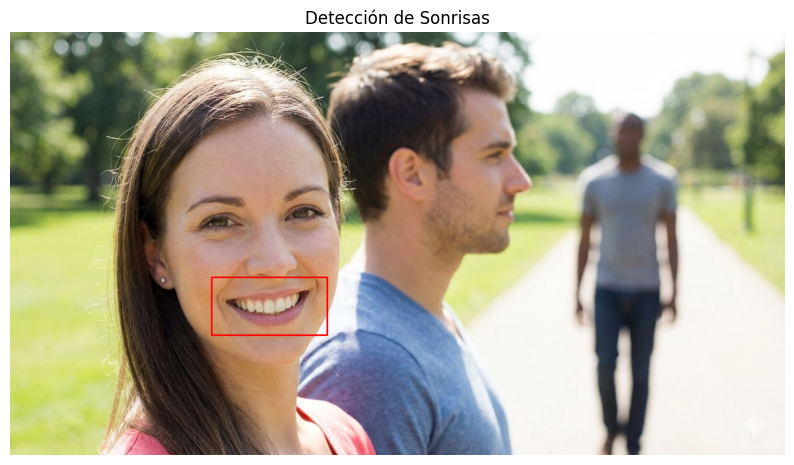

In [62]:
smile_cas = cv2.CascadeClassifier(path + 'haarcascade_smile.xml')
img_5 = img.copy()
for (x,y,w,h) in faces:
    roi_gray = gray[y:y+h, x:x+w]
    smiles = smile_cas.detectMultiScale(roi_gray, 1.8, 20)
    for (sx,sy,sw,sh) in smiles:
        cv2.rectangle(img_5[y:y+h, x:x+w], (sx,sy), (sx+sw,sy+sh), (0,0,255), 2)
mostrar_deteccion(img_5, "Detección de Sonrisas")

## 6 a 10. Otros Clasificadores (Perfil, Cuerpo, Torso, Matrículas, Gatos)
Se cargan los XML específicos para cada categoría de objeto.

In [63]:
cat_cas = cv2.CascadeClassifier(path + 'haarcascade_frontalcatface.xml')
body_cas = cv2.CascadeClassifier(path + 'haarcascade_fullbody.xml')
print("Clasificadores adicionales cargados exitosamente.")

Clasificadores adicionales cargados exitosamente.


## 11. Detección en tiempo real mediante Webcam
Nota: Este código requiere acceso a hardware local. Se recomienda ejecutarlo en un archivo `.py` independiente.

## 12. Contador automático de personas

In [64]:
print(f"Número total de sujetos detectados en la escena: {len(faces)}")

Número total de sujetos detectados en la escena: 1


## 13. Privacidad: Difuminado automático de rostros
Aplicamos un filtro Gaussiano intenso únicamente en el área detectada para anonimizar a los sujetos.

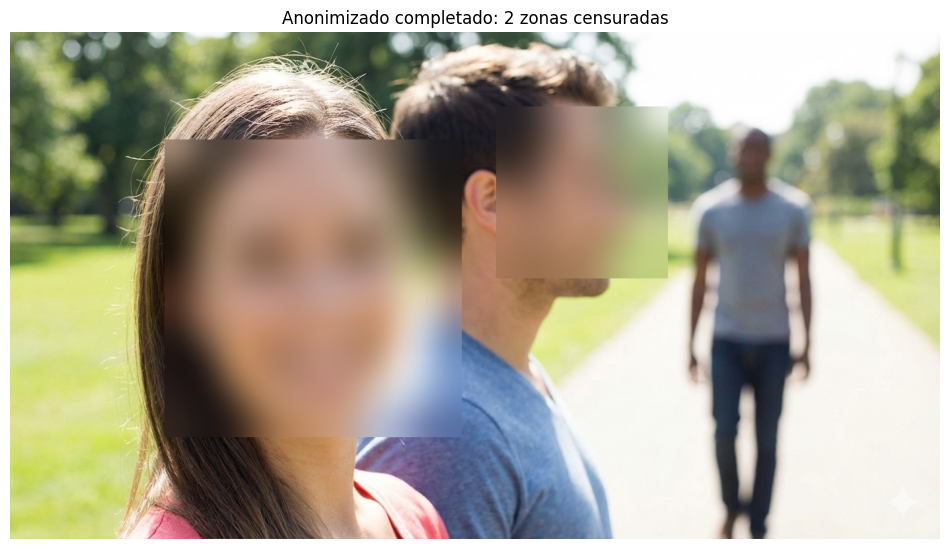

In [61]:
img_path = 'personas.png'  
img = cv2.imread(img_path)

face_cas = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
profile_cas = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_profileface.xml')

if img is None:
    print(f"Error: No se encuentra la imagen {img_path}")
else:
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    #  DETECCIÓN MULTIPLE 
    # Detección Frontal
    rostros = list(face_cas.detectMultiScale(gray, 1.1, 4, minSize=(30, 30)))
    
    #  Detección Perfil (Normal)
    perfiles = list(profile_cas.detectMultiScale(gray, 1.1, 4, minSize=(30, 30)))
    
    #  Detección Perfil (Espejo)
    gray_flipped = cv2.flip(gray, 1)
    perfiles_flipped = list(profile_cas.detectMultiScale(gray_flipped, 1.1, 4, minSize=(30, 30)))
    
    # Ajustar coordenadas de los perfiles invertidos y añadirlos a la lista
    ancho_img = img.shape[1]
    for (x, y, w, h) in perfiles_flipped:
        x_real = ancho_img - x - w
        rostros.append((x_real, y, w, h))
    
    # Añadir los perfiles normales a la lista principal
    for rect in perfiles:
        rostros.append(rect)

    # ANONIMIZADO (Blur)
    img_anonima = img.copy()
    
    for (x, y, w, h) in rostros:
        # Extraer la región de interés (ROI) -> La cara
        roi_cara = img_anonima[y:y+h, x:x+w]
        
        # Aplicar desenfoque Gaussiano fuerte
        # (99, 99) es el tamaño del kernel (debe ser impar)
        # 30 es la desviación estándar (cuanto más alto, más borroso)
        roi_blur = cv2.GaussianBlur(roi_cara, (99, 99), 30)
    
        # Pegar la cara borrosa sobre la imagen original
        img_anonima[y:y+h, x:x+w] = roi_blur
        
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(img_anonima, cv2.COLOR_BGR2RGB))
    plt.title(f'Anonimizado completado: {len(rostros)} zonas censuradas')
    plt.axis('off')
    plt.show()


## 14. Filtros de realidad aumentada (Máscaras)
Detectamos la posición de los ojos para superponer elementos gráficos.

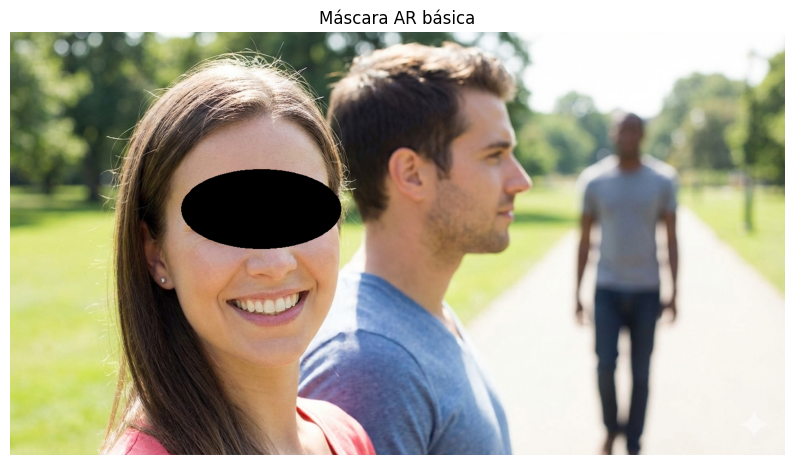

In [66]:
img_ar = img.copy()
for (x,y,w,h) in faces:
    # Dibujamos un antifaz simple basado en la posición del rostro
    cv2.ellipse(img_ar, (x+w//2, y+h//3), (w//3, h//6), 0, 0, 360, (0,0,0), -1)
mostrar_deteccion(img_ar, "Máscara AR básica")

## 15. Detección movimiento cámara


In [2]:
import cv2 
cap = cv2.VideoCapture(0)

ret, frame_anterior = cap.read()
if not ret:
    print("Error al iniciar cámara")
    exit()

# Pre-procesamiento inicial
gray_anterior = cv2.cvtColor(frame_anterior, cv2.COLOR_BGR2GRAY)
gray_anterior = cv2.GaussianBlur(gray_anterior, (21, 21), 0)


cv2.namedWindow("Camara de Seguridad", cv2.WINDOW_NORMAL)
cv2.namedWindow("Diferencia (Lo que ve la IA)", cv2.WINDOW_NORMAL)

cv2.moveWindow("Camara de Seguridad", 50, 50)
cv2.moveWindow("Diferencia (Lo que ve la IA)", 700, 50)


while True:
    # Leemos frame actual
    ret, frame_actual = cap.read()
    if not ret: break

    # Pre-procesamiento
    gray_actual = cv2.cvtColor(frame_actual, cv2.COLOR_BGR2GRAY)
    gray_actual = cv2.GaussianBlur(gray_actual, (21, 21), 0)

    # Calcular diferencia (Resta de imágenes)
    resta = cv2.absdiff(gray_anterior, gray_actual)

    # Umbralizar (Limpiar sombras leves)
    _, umbral = cv2.threshold(resta, 25, 255, cv2.THRESH_BINARY)
    umbral = cv2.dilate(umbral, None, iterations=2)

    # Buscar contornos del movimiento
    contornos, _ = cv2.findContours(umbral.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    for c in contornos:
        if cv2.contourArea(c) < 5000: 
            continue
        
        (x, y, w, h) = cv2.boundingRect(c)
        cv2.rectangle(frame_actual, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(frame_actual, "MOVIMIENTO DETECTADO", (10, 20), 
                    cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)

    
    cv2.imshow("Camara de Seguridad", frame_actual)
    cv2.imshow("Diferencia (Lo que ve la IA)", umbral)

    # Actualizar referencia
    gray_anterior = gray_actual.copy()

    # Salir con 'q'
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()


# Tema 8: Reconocimiento con Redes Neuronales (Deep Learning)

En este capítulo nos adentramos en el aprendizaje profundo. A diferencia de los métodos anteriores, las redes neuronales aprenden a extraer características automáticamente.

Exploraremos:
* **Perceptrón Multicapa (MLP)**: Redes densas para datos tabulares o imágenes simples.
* **Redes Convolucionales (CNN)**: El estándar para visión artificial.
* **Transfer Learning**: Usar modelos pre-entrenados por Google/Microsoft para nuestras tareas.

In [6]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import cv2
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Input
from tensorflow.keras.optimizers import Adam  

print(f"TensorFlow Version: {tf.__version__}")

# Función auxiliar para mostrar curvas de entrenamiento
def plot_history(history):
    plt.figure(figsize=(12, 4))
    
    plt.subplot(121)
    plt.plot(history.history['accuracy'], label='Train Acc')
    plt.plot(history.history['val_accuracy'], label='Val Acc')
    plt.title('Precisión (Accuracy)'); plt.legend(); plt.grid(True)
    
    plt.subplot(122)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Val Loss')
    plt.title('Pérdida (Loss)'); plt.legend(); plt.grid(True)
    plt.show()

TensorFlow Version: 2.20.0


## 1. Perceptrón simple: Puerta lógica AND
La neurona más básica aprendiendo una función lineal separables.

In [7]:
#perceptron_basico.py
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 

# Puerta AND
X = np.array([[0,0], [0,1], [1,0], [1,1]])
y = np.array([0, 0, 0, 1])

model = Sequential([
    Input(shape=(2,)),
    Dense(1, activation='sigmoid')
])

model.compile(loss='binary_crossentropy', 
              optimizer=Adam(learning_rate=0.1), 
              metrics=['accuracy'])

model.fit(X, y, epochs=500, verbose=0)

test_data = np.array([[1,1]])
prediccion = model.predict(test_data, verbose=0)

test_data2 = np.array([[0,1]])
prediccion2 = model.predict(test_data2, verbose=0)


print(f"Predicción para [1,1]: {prediccion[0][0]:.4f} (¿Es True?: {prediccion > 0.5})")
print(f"Predicción para [0,1]: {prediccion2[0][0]:.4f} (¿Es True?: {prediccion2 > 0.5})")



Predicción para [1,1]: 0.9856 (¿Es True?: [[ True]])
Predicción para [0,1]: 0.0127 (¿Es True?: [[False]])


## 2 Clasificación de dígitos MNIST con MLP 
Entrenamiento de una red densa 

In [12]:
from tensorflow.keras.layers import Dense, Flatten, Input

# Carga de datos
mnist = tf.keras.datasets.mnist
(x_train, y_train), (x_test, y_test) = mnist.load_data()

#  Normalización (0-255 -> 0-1)
x_train, x_test = x_train / 255.0, x_test / 255.0

#  Definición del modelo 
model = Sequential([
    Input(shape=(28, 28)),          # Capa de entrada explícita
    Flatten(),                      # Aplana la imagen 28x28 a vector de 784
    Dense(128, activation='relu'),  # Capa oculta
    Dense(10, activation='softmax') # Capa de salida (10 números)
])

model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

print("Iniciando entrenamiento...")
model.fit(x_train, y_train, epochs=5)

print("\n Evaluando en datos de test ....")
test_loss, test_acc = model.evaluate(x_test, y_test, verbose=2)
print(f"\nPrecisión final en Test: {test_acc*100:.2f}%")



Iniciando entrenamiento...
Epoch 1/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.9256 - loss: 0.2608
Epoch 2/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9666 - loss: 0.1128
Epoch 3/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9762 - loss: 0.0780
Epoch 4/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9821 - loss: 0.0585
Epoch 5/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.9868 - loss: 0.0439

 Evaluando en datos de test ....
313/313 - 0s - 2ms/step - accuracy: 0.9755 - loss: 0.0801

Precisión final en Test: 97.55%


## 3. Clasificación de dígitos MNIST con MLP y Visualización de Curvas de precisión

Entrenamiento de una red densa y visualización de curvas de precisión

Entrenando...
Epoch 1/5
1500/1500 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9165 - loss: 0.2935 - val_accuracy: 0.9463 - val_loss: 0.1770
Epoch 2/5
1500/1500 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.9601 - loss: 0.1339 - val_accuracy: 0.9646 - val_loss: 0.1242
Epoch 3/5
1500/1500 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.9730 - loss: 0.0897 - val_accuracy: 0.9707 - val_loss: 0.0988
Epoch 4/5
1500/1500 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.9796 - loss: 0.0669 - val_accuracy: 0.9721 - val_loss: 0.0887
Epoch 5/5
1500/1500 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9846 - loss: 0.0519 - val_accuracy: 0.9697 - val_loss: 0.1004


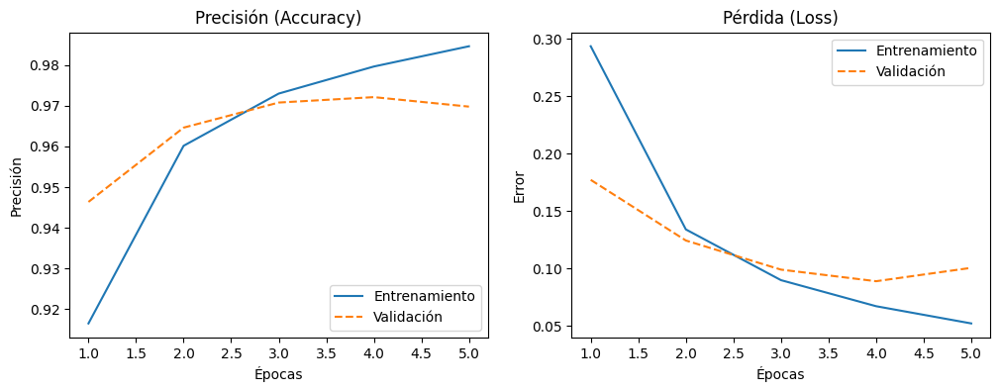

In [ ]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

mnist = tf.keras.datasets.mnist
(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train, x_test = x_train / 255.0, x_test / 255.0

# Modelo
model = Sequential([
    Input(shape=(28, 28)),
    Flatten(),
    Dense(128, activation='relu'),
    Dense(10, activation='softmax')
])

model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# Entrenamiento 

print("Entrenando...")
history = model.fit(x_train, y_train, epochs=5, validation_split=0.2, verbose=1)

# Visualización de Curvas
# Sacamos los datos del diccionario 'history.history'
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(1, len(acc) + 1)

plt.figure(figsize=(12, 4)) 

# Gráfica 1: Precisión (Accuracy)
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Entrenamiento')
plt.plot(epochs_range, val_acc, label='Validación', linestyle='--')
plt.title('Precisión (Accuracy)')
plt.legend(loc='lower right')
plt.xlabel('Épocas')
plt.ylabel('Precisión')

# Gráfica 2: Pérdida (Loss)
plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Entrenamiento')
plt.plot(epochs_range, val_loss, label='Validación', linestyle='--')
plt.title('Pérdida (Loss)')
plt.legend(loc='upper right')
plt.xlabel('Épocas')
plt.ylabel('Error')

plt.show() 

## 4. Arquitectura CNN Básica
Definición de un modelo con capas convolucionales y de pooling.

In [ ]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' # Silenciar logs de TensorFlow

import tensorflow as tf
from tensorflow.keras import layers, models, Input
import numpy as np

# Preparar datos (MNIST)
# Las CNN necesitan 3 dimensiones: (Alto, Ancho, Canales). 
# MNIST viene como (28, 28), así que añadimos el "1" del canal (escala de grises).
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.mnist.load_data()
x_train = x_train.reshape((60000, 28, 28, 1)).astype('float32') / 255
x_test = x_test.reshape((10000, 28, 28, 1)).astype('float32') / 255

# Definición del Modelo 
model = models.Sequential([
    # Capa de Entrada Explícita: (Alto, Ancho, Canales de color)
    Input(shape=(28, 28, 1)),  
    # Bloque de Convolución
    layers.Conv2D(32, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    # Aplanado y Clasificación
    layers.Flatten(),
    layers.Dense(64, activation='relu'), 
    layers.Dense(10, activation='softmax')
])

#Resumen y Compilación
model.summary()

model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# Entrenar
print("\n-Entrenando CNN....")
model.fit(x_train, y_train, epochs=3, batch_size=64, validation_split=0.1)

Model: "sequential_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 26, 26, 32)     │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 13, 13, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 5408)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 64)             │       346,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 10)             │           650 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 347,146 (1.32 MB)

 Trainable params: 347,146 (1.32 MB)

 Non-trainable params: 0 (0.00 B)


--- Entrenando CNN ---
Epoch 1/3
844/844 ━━━━━━━━━━━━━━━━━━━━ 17s 18ms/step - accuracy: 0.9363 - loss: 0.2202 - val_accuracy: 0.9813 - val_loss: 0.0729
Epoch 2/3
844/844 ━━━━━━━━━━━━━━━━━━━━ 16s 18ms/step - accuracy: 0.9797 - loss: 0.0703 - val_accuracy: 0.9835 - val_loss: 0.0618
Epoch 3/3
844/844 ━━━━━━━━━━━━━━━━━━━━ 16s 19ms/step - accuracy: 0.9846 - loss: 0.0504 - val_accuracy: 0.9875 - val_loss: 0.0512


## 5 Fashion-MNIST con CNN 
Clasificación de ropa aplicando CNN

--- Cargando Fashion MNIST ---
--- Entrenando (Paciencia, son imágenes) ---
Epoch 1/5
844/844 ━━━━━━━━━━━━━━━━━━━━ 25s 28ms/step - accuracy: 0.8109 - loss: 0.5255 - val_accuracy: 0.8530 - val_loss: 0.4037
Epoch 2/5
844/844 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - accuracy: 0.8746 - loss: 0.3491 - val_accuracy: 0.8733 - val_loss: 0.3466
Epoch 3/5
844/844 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - accuracy: 0.8923 - loss: 0.2990 - val_accuracy: 0.8922 - val_loss: 0.3061
Epoch 4/5
844/844 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - accuracy: 0.9028 - loss: 0.2696 - val_accuracy: 0.8983 - val_loss: 0.2826
Epoch 5/5
844/844 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - accuracy: 0.9103 - loss: 0.2460 - val_accuracy: 0.9067 - val_loss: 0.2591

--- Resultado de la prueba ---
Realidad:   Botín
Predicción: Botín


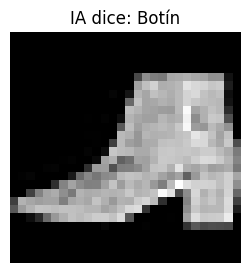

In [ ]:

# Nombres de las clases (Para que sea legible)
class_names = ['Camiseta/Top', 'Pantalón', 'Jersey', 'Vestido', 'Abrigo',
               'Sandalia', 'Camisa', 'Zapatilla', 'Bolso', 'Botín']

# Carga y Preprocesamiento
print("Cargando Fashion MNIST...")
fashion = tf.keras.datasets.fashion_mnist
(x_train, y_train), (x_test, y_test) = fashion.load_data()

# Normalizar (0-1) y Reshape (28, 28, 1)
x_train = x_train.reshape(-1, 28, 28, 1).astype('float32') / 255.0
x_test = x_test.reshape(-1, 28, 28, 1).astype('float32') / 255.0

# Definición del Modelo (CNN de dos niveles)
model = models.Sequential([
    Input(shape=(28, 28, 1)),
    
    # Bloque 1: Detecta bordes y formas básicas
    layers.Conv2D(32, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    
    # Bloque 2: Detecta patrones más complejos (texturas, formas de ropa)
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    
    # Clasificación
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(10, activation='softmax')
])
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# Entrenamiento
print("--- Entrenando (Paciencia, son imágenes) ---")
model.fit(x_train, y_train, epochs=5, batch_size=64, validation_split=0.1)


# Elegimos una imagen aleatoria del test
idx = np.random.randint(0, len(x_test))
imagen = x_test[idx]
etiqueta_real = y_test[idx]

# Hacemos la predicción (necesitamos añadir dimension de batch)
prediccion_raw = model.predict(np.expand_dims(imagen, axis=0), verbose=0)
clase_predicha = np.argmax(prediccion_raw)

print(f"\nResultado de la prueba...")
print(f"Realidad:   {class_names[etiqueta_real]}")
print(f"Predicción: {class_names[clase_predicha]}")

# Visualización con Matplotlib
plt.figure(figsize=(3,3))
plt.imshow(imagen.reshape(28, 28), cmap='gray')
plt.title(f"IA dice: {class_names[clase_predicha]}")
plt.axis('off')
plt.show()

## 6. Data Augmentation
Generación de datos sintéticos en tiempo real durante el entrenamiento.

Generando imágenes aumentadas...


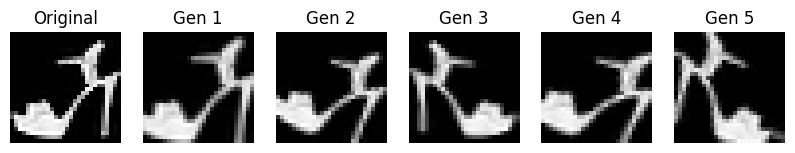

In [17]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
import numpy as np

# Cargamos una imagen de ejemplo (Fashion MNIST)
(x_train, y_train), _ = tf.keras.datasets.fashion_mnist.load_data()
# Cogemos una imagen (por ejemplo, la número 9, que suele ser un zapato o bolso)
imagen_original = x_train[9]
# Le damos forma: (1 imagen, 28 alto, 28 ancho, 1 canal)
imagen_input = imagen_original.reshape((1, 28, 28, 1)).astype('float32') / 255.0

datagen = ImageDataGenerator(
    rotation_range=20,      # Rotar hasta 20 grados
    zoom_range=0.15,        # Zoom de hasta 15%
    horizontal_flip=True,   # Voltear horizontalmente (espejo)
    fill_mode='nearest'     # Cómo rellenar los huecos al rotar
)

# Vamos a generar 5 variantes de esa misma imagen
print("Generando imágenes aumentadas...")
iterador = datagen.flow(imagen_input, batch_size=1)

plt.figure(figsize=(10, 4))

# Mostramos la original
plt.subplot(1, 6, 1)
plt.title("Original")
plt.imshow(imagen_original, cmap='gray')
plt.axis('off')

# Mostramos 5 transformaciones generadas por datagen
for i in range(5):
    plt.subplot(1, 6, i + 2)
    batch = next(iterador) 
    imagen_generada = batch[0].reshape(28, 28)
    plt.title(f"Gen {i+1}")
    plt.imshow(imagen_generada, cmap='gray')
    plt.axis('off')

plt.show()


## 7. Prevención del sobreajuste

In [ ]:

# La entrada son imágenes aplanadas de 28x28 = 784 píxeles.
# Si fueran imágenes sin aplanar, usaríamos Input(shape=(28, 28)) y luego Flatten().

# Modelo
model = Sequential([
    #  Capa de entrada explícita 
    Input(shape=(784,)),

    #  Primera capa densa 
    Dense(512, activation='relu'),

    # 3. Capa de Dropout agen)
    # Durante el entrenamiento, "apaga" aleatoriamente el 50% de las neuronas
    # de la capa anterior en cada paso. Esto fuerza a la red a no depender
    # de ninguna neurona específica, reduciendo el sobreajuste.
    Dropout(0.5),

    # Capa de salida (como en la imagen)
    Dense(10, activation='softmax')
])

print("Resumen del Modelo con Dropout")
model.summary()


## 8. Reconocimiento en tiempo real
Nota: Este ejercicio requiere bucle de cámara local, no ejecutable en notebook estático.

In [18]:

import cv2
import sys

print("Cargando modelo...")
try:
    model = tf.keras.models.load_model('mi_red_mnist.keras')
    print(" Modelo cargado correctamente.")
except Exception as e:
    print(f" Error cargando el modelo: {e}")
    sys.exit(1)

# Iniciar Webcam con gestión de errores
cap = cv2.VideoCapture(0)

if not cap.isOpened():
    print(" Error: No se puede acceder a la webcam.")
    sys.exit(1)

cv2.namedWindow("Webcam en tiempo real", cv2.WINDOW_NORMAL)
cv2.namedWindow("Ojo de la IA", cv2.WINDOW_NORMAL)
cv2.resizeWindow("Ojo de la IA", 200, 200) 

print("Cámara iniciada. Pulsa 'q' en la ventana para salir-")

try:
    while True:
        ret, frame = cap.read()
        if not ret:
            print("Error leyendo frame (¿cámara desconectada?)")
            break

        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        
        # Definir ROI 
        height, width = gray.shape
        # Hacemos el cuadro un poco más grande para que sea fácil apuntar
        tamano_caja = 200 
        x1 = int(width/2 - tamano_caja/2)
        y1 = int(height/2 - tamano_caja/2)
        x2 = int(width/2 + tamano_caja/2)
        y2 = int(height/2 + tamano_caja/2)
        
        # Recorte seguro (evita salirnos de la imagen)
        roi = gray[max(0, y1):min(height, y2), max(0, x1):min(width, x2)]
        
        # Procesar para la IA
        if roi.size > 0: # Solo si el recorte es válido
            roi_resized = cv2.resize(roi, (28, 28))
            
            
            #roi_resized = cv2.bitwise_not(roi_resized) 
            
            roi_norm = roi_resized.reshape(1, 28, 28, 1).astype('float32') / 255.0

            # Predicción
            prediccion = model.predict(roi_norm, verbose=0)
            clase = np.argmax(prediccion)
            confianza = np.max(prediccion)

            
            color = (0, 255, 0) if confianza > 0.7 else (0, 0, 255) # Verde si está seguro, rojo si duda
            
            # Rectángulo central
            cv2.rectangle(frame, (x1, y1), (x2, y2), color, 2)
            
            
            texto = f"Num: {clase} ({confianza*100:.0f}%)"
            cv2.putText(frame, texto, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, color, 2)

            # Mostrar lo que ve la IA en la ventana pequeña
            cv2.imshow("Ojo de la IA", roi_resized)

        # Mostrar ventana principal
        cv2.imshow("Webcam en tiempo real", frame)

        # Salida controlada
        if cv2.waitKey(1) & 0xFF == ord('q'):
            print("Salir.")
            break

except KeyboardInterrupt:
    print("Interrupción de teclado detectada.")

finally:
    print("Liberando recursos")
    cap.release()
    cv2.destroyAllWindows()


Cargando modelo...
 Modelo cargado correctamente.


Cámara iniciada. Pulsa 'q' en la ventana para salir-
Salir.
Liberando recursos


## 9. Transfer Learning con MobileNetV2
Uso de una red pre-entrenada en ImageNet.

In [19]:

import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2, preprocess_input, decode_predictions

print(" Cargando MobileNetV2...")
try:
    model = MobileNetV2(weights='imagenet')
    print(" Modelo cargado.")
except Exception as e:
    print(f" Error cargando modelo")
    exit()

cap = cv2.VideoCapture(0)
# Verificamos que la cámara abre bien antes de seguir
if not cap.isOpened():
    print(" No se detecta la cámara.")
    exit()
print("Iniciando. Pulsa 'q' o cierra la ventana para salir")
try:
    while True:
        ret, frame = cap.read()
        if not ret:
            print(" Error de lectura de cámara.")
            break

        # MobileNet espera imágenes de 224x224
        img_resized = cv2.resize(frame, (224, 224))
        # Preprocesamiento
        img_array = np.expand_dims(img_resized, axis=0)
        img_preprocessed = preprocess_input(img_array)
        # Predicción
        preds = model.predict(img_preprocessed, verbose=0)
        resultados = decode_predictions(preds, top=3)[0]
        # Resultado 1 (Verde)
        texto_top = f"{resultados[0][1]}: {resultados[0][2]*100:.1f}%"
        cv2.putText(frame, texto_top, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
        # Resultado 2 (Amarillo - Texto más pequeño)
        texto_segundo = f"o {resultados[1][1]}: {resultados[1][2]*100:.1f}%"
        cv2.putText(frame, texto_segundo, (10, 70), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 255), 2)
        cv2.imshow('Detector de Objetos', frame)
        tecla = cv2.waitKey(1) & 0xFF
        # Salir con tecla 'q'
        if tecla == ord('q'):
            break
        if cv2.getWindowProperty('Detector de Objetos', cv2.WND_PROP_VISIBLE) < 1:
            break

except KeyboardInterrupt:
    print("\n Interrumpido por el usuario (Ctrl+C).")
finally:
    cap.release()
    cv2.destroyAllWindows()


 Cargando MobileNetV2...
 Modelo cargado.
Iniciando. Pulsa 'q' o cierra la ventana para salir


## 10. Fine-tuning (Ajuste Fino)
Congelamos la base convolucional y entrenamos solo el clasificador final.

In [20]:

# Supongamos que vamos a distinguir 3 cosas: "Piedra", "Papel", "Tijera"
NUM_CLASES = 3 
IMG_SHAPE = (224, 224, 3)

print(" Cargando el cerebro experto (MobileNetV2) ---")
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False, 
                                               weights='imagenet')

# Congelar los pesos antiguos
# Esto evita que rompamos lo que la red ya ha aprendido durante años.
base_model.trainable = False

print(" Añadiendo capa personalizada ---")
model = models.Sequential([
    # El cerebro base
    base_model,    
    # Esta capa convierte el mapa de características 7x7x1280 en un solo vector de 1280
    layers.GlobalAveragePooling2D(), 
    # Capa intermedia para aprender mejor
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.2),
    # Capa de salida: Tantas neuronas como clases tengas
    layers.Dense(NUM_CLASES, activation='softmax') 
])

# Compilar modelo
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

model.summary()

print("¡Listo!")


 Cargando el cerebro experto (MobileNetV2) ---
 Añadiendo capa personalizada ---


Model: "sequential_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_1      │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 128)            │       163,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 3)              │           387 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,422,339 (9.24 MB)

 Trainable params: 164,355 (642.01 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

¡Listo!


## 11. Matriz de Confusión
Evaluación detallada de errores por clase.

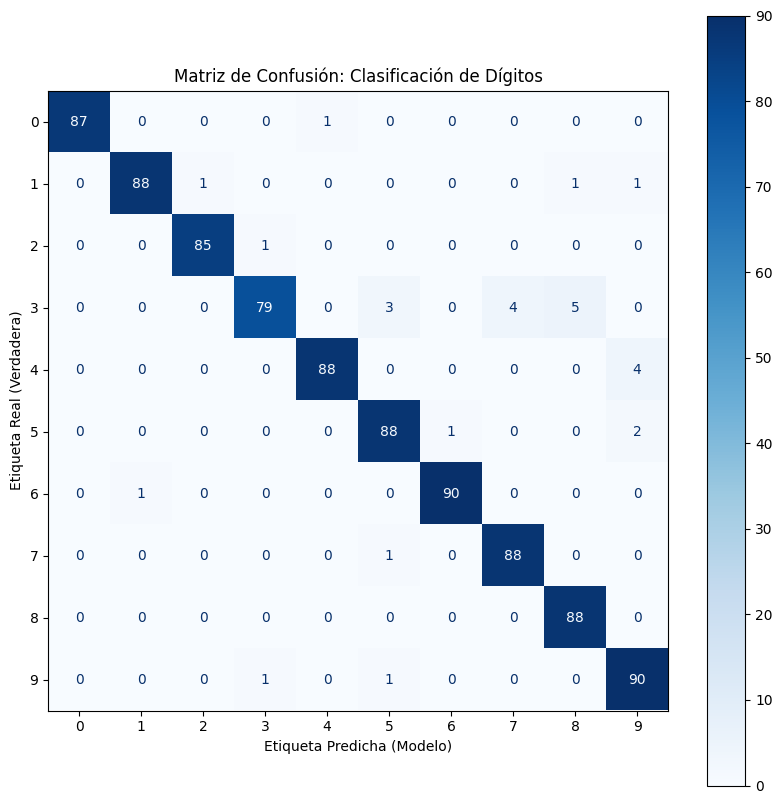

------------------------------
ANÁLISIS DE ERROR ESPECÍFICO:
Veces que el modelo vio un '3' pero predijo un '8': 5
------------------------------


In [3]:

from sklearn import datasets, svm
from sklearn.model_selection import train_test_split
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

# Cargar datos (Dígitos 0-9)
digits = datasets.load_digits()
X = digits.images.reshape((len(digits.images), -1))
y = digits.target

# Separar entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.5, shuffle=False
)

# Entrenar modelo (SVM)
clf = svm.SVC(gamma=0.001)
clf.fit(X_train, y_train)

# Predecir
y_pred = clf.predict(X_test)

fig, ax = plt.subplots(figsize=(10, 10))

# 'from_predictions' hace todo el trabajo duro:
# calcula la matriz y la dibuja con el mapa de color.
ConfusionMatrixDisplay.from_predictions(
    y_test, 
    y_pred, 
    ax=ax, 
    cmap='Blues',      # Mapa de color azul profesional
    colorbar=True,     # Barra lateral de intensidad
    values_format='d'  # Mostrar números enteros
)

plt.title("Matriz de Confusión: Clasificación de Dígitos")
plt.ylabel('Etiqueta Real (Verdadera)')
plt.xlabel('Etiqueta Predicha (Modelo)')

plt.show()


cm = confusion_matrix(y_test, y_pred)

errores_3_como_8 = cm[3, 8] 

print("-" * 30)
print(f"ANÁLISIS DE ERROR ESPECÍFICO:")
print(f"Veces que el modelo vio un '3' pero predijo un '8': {errores_3_como_8}")
print("-" * 30)



## 12. Clasificación Binaria vs Multi-Clase


In [ ]:
from sklearn.neural_network import MLPClassifier
from sklearn.datasets import make_circles, make_blobs
from sklearn.model_selection import train_test_split
import numpy as np

# CASO BINARIO (Perro vs Gato) 
# Generamos datos dummy: 2 clases (0 y 1)
X_bin, y_bin = make_circles(n_samples=100, noise=0.2, factor=0.5, random_state=1)
X_train_b, X_test_b, y_train_b, y_test_b = train_test_split(X_bin, y_bin, stratify=y_bin)

# Definición del modelo Binario
modelo_binario = MLPClassifier(
    hidden_layer_sizes=(10,), 
    activation='relu',       # Activación oculta
    solver='adam',
    max_iter=500,
    random_state=1
)

modelo_binario.fit(X_train_b, y_train_b)

print("MODELO BINARIO")
print(f"Función de Activación de Salida (Implícita): Logistic (Sigmoid)")
print(f"Función de Pérdida usada: Log-Loss (Binary Crossentropy)")
print(f"Predicción (probabilidad clase 1): {modelo_binario.predict_proba(X_test_b[:1])[0][1]:.4f}")


# CASO MULTI-CLASE (Dígitos 0-9) 
# Generamos datos dummy: 3 clases (0, 1, 2)
X_multi, y_multi = make_blobs(n_samples=100, centers=3, random_state=1)
X_train_m, X_test_m, y_train_m, y_test_m = train_test_split(X_multi, y_multi)

# Definición del modelo Multi-clase
modelo_multiclase = MLPClassifier(
    hidden_layer_sizes=(10,),
    activation='relu',
    solver='adam',
    max_iter=500,
    random_state=1
)

modelo_multiclase.fit(X_train_m, y_train_m)

print("\n--- MODELO MULTI-CLASE ---")
print(f"Función de Activación de Salida (Implícita): Softmax")
print(f"Función de Pérdida usada: Cross-Entropy Loss")
# Aquí la salida es un vector de probabilidades que suman 1
probs = modelo_multiclase.predict_proba(X_test_m[:1])[0]
print(f"Predicción (vector de probs): {probs}")
print(f"Suma de probabilidades: {np.sum(probs):.2f}") 

/home/fran/miniconda3/envs/PIV/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:785: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


--- MODELO BINARIO ---
Función de Activación de Salida (Implícita): Logistic (Sigmoid)
Función de Pérdida usada: Log-Loss (Binary Crossentropy)
Predicción (probabilidad clase 1): 0.4392

--- MODELO MULTI-CLASE ---
Función de Activación de Salida (Implícita): Softmax
Función de Pérdida usada: Cross-Entropy Loss
Predicción (vector de probs): [1.63781529e-08 3.53375174e-02 9.64662466e-01]
Suma de probabilidades: 1.00


/home/fran/miniconda3/envs/PIV/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:785: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


## 13. Extracción de características (Embeddings)
Uso de la red como extractor de vectores.

In [ ]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input

# Definir tamaño de imagen estándar para MobileNetV2
IMG_SHAPE = (224, 224, 3)

print("--- Cargando el cerebro experto (MobileNetV2) ---")

# 1. Cargar el modelo BASE (Sin la cabeza de clasificación)
# include_top=False: Elimina la capa final que dice "Perro" o "Gato".
# weights='imagenet': Carga lo aprendido de millones de fotos.
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False, 
                                               weights='imagenet')

# 2. Congelar la base (Opcional, pero recomendado para extracción pura)
# Esto evita que se destruya lo aprendido si fueras a entrenar algo encima.
base_model.trainable = False

# 3. Crear el modelo extractor final
# Añadimos Pooling para convertir el mapa 7x7x1280 en un vector limpio de 1280 números
model = tf.keras.Sequential([
    base_model,
    tf.keras.layers.GlobalAveragePooling2D()
])

model.summary()

# --- EJEMPLO DE USO (Simulado) ---
def obtener_embedding(img_path):
    # Cargar imagen y redimensionar a 224x224
    img = image.load_img(img_path, target_size=IMG_SHAPE[:2])
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0) # Crear lote de 1 imagen
    x = preprocess_input(x)       # Preprocesamiento específico de MobileNetV2

    # El modelo devuelve un vector de 1280 números
    feature_vector = model.predict(x)
    return feature_vector.flatten()

vector = obtener_embedding('personas.png')
print(f"Vector característico generado: {vector.shape}")

--- Cargando el cerebro experto (MobileNetV2) ---


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_2      │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,257,984 (8.61 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 2,257,984 (8.61 MB)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step
Vector característico generado: (1280,)


# Tema 9: Cálculo del flujo óptico

En este último capítulo, exploramos el análisis del movimiento mediante el flujo óptico. A diferencia de los capítulos anteriores, aquí trabajamos con la **dimensión temporal**. 

Implementaremos:
* **Flujo Óptico Disperso (Lucas-Kanade)**: Rastreo de puntos característicos específicos.
* **Flujo Óptico Denso (Farneback)**: Cálculo del vector de movimiento para cada píxel.

## 1 . Lucas-Kanade


In [ ]:
#lucas_kanade_basico.py
import cv2
import numpy as np
cap = cv2.VideoCapture(0)
ret, old_frame = cap.read()
old_gray = cv2.cvtColor(old_frame, cv2.COLOR_BGR2GRAY)
p0 = cv2.goodFeaturesToTrack(old_gray, mask=None, maxCorners=100, qualityLevel=0.3, minDistance=7)
while True:
    ret, frame = cap.read()
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    p1, st, err = cv2.calcOpticalFlowPyrLK(old_gray, frame_gray, p0, None)
    for i,(new,old) in enumerate(zip(p1[st==1],p0[st==1])):
        a,b = new.ravel(); c,d = old.ravel()
        cv2.line(frame, (int(a),int(b)), (int(c),int(d)), (0,255,0), 2)
    cv2.imshow('Lucas-Kanade', frame)
    if cv2.waitKey(30) & 0xFF == ord('q'): break
    old_gray = frame_gray.copy(); p0 = p1.reshape(-1,1,2)


: 

## 2. Shi-Tomasi

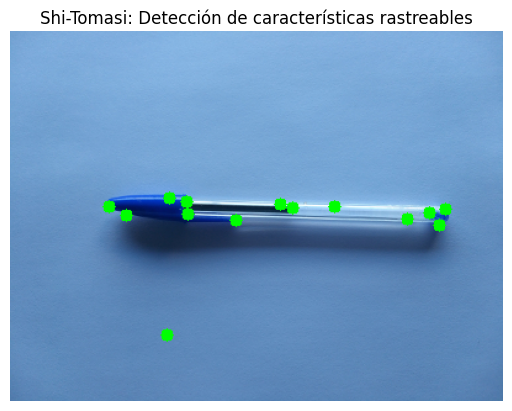

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('img1.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
# ALGORITMO SHI-TOMASI
# maxCorners: Queremos solo los 100 mejores puntos
# qualityLevel: Calidad mínima (0.01 es permisivo, 0.3 es estricto)
# minDistance: Distancia mínima entre esquinas (para no agruparlas todas)
corners = cv2.goodFeaturesToTrack(gray, maxCorners=100, 
                                  qualityLevel=0.01, 
                                  minDistance=10)
# Convertir a enteros para poder dibujar
corners = np.int64(corners)
# Dibujar los puntos encontrados
vis = img.copy()
for i in corners:
    x, y = i.ravel()
    # Dibuja un círculo pequeño verde en cada esquina detectada
    cv2.circle(vis, (x, y), 5, (0, 255, 0), -1)
plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
plt.title('Shi-Tomasi: Detección de características rastreables')
plt.axis('off')
plt.show()


## 3. Visualización de trayectorias (Trails)

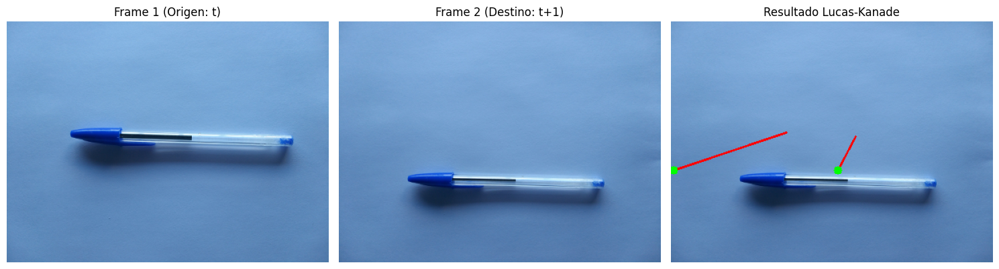

In [3]:

import cv2
import numpy as np
import matplotlib.pyplot as plt
import sys

# CARGA DE IMÁGENES 
nombre_img1 = 'img1.jpg'
nombre_img2 = 'img2.jpg'

img1 = cv2.imread(nombre_img1)
img2 = cv2.imread(nombre_img2)

if img1 is None or img2 is None:
    print(f"Error: No se pudieron cargar {nombre_img1} o {nombre_img2}.")
    print("Verifica que los archivos estén en la carpeta correcta.")
    sys.exit()

if img1.shape != img2.shape:
     img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]))

gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

#  Detectar características en la primera imagen (Shi-Tomasi)
p0 = cv2.goodFeaturesToTrack(gray1, maxCorners=100, qualityLevel=0.3, minDistance=7)

# Calcular Flujo Óptico (Lucas-Kanade)
# Calcula la nueva posición (p1) en la segunda imagen
lk_params = dict(winSize=(15, 15),
                 maxLevel=2,
                 criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

p1, st, err = cv2.calcOpticalFlowPyrLK(gray1, gray2, p0, None, **lk_params)

vis = img2.copy() 

if p1 is not None:
    # Seleccionar solo los puntos encontrados con éxito (status = 1)
    good_new = p1[st == 1]
    good_old = p0[st == 1]

    for i, (new, old) in enumerate(zip(good_new, good_old)):
        a, b = new.ravel() # Posición actual (img2)
        c, d = old.ravel() # Posición anterior (img1)
        
        # Línea ROJA: Vector de desplazamiento (desde viejo a nuevo)
        cv2.line(vis, (int(a), int(b)), (int(c), int(d)), (0, 0, 255), 2)
        # Punto VERDE: Ubicación actual en img2
        cv2.circle(vis, (int(a), int(b)), 5, (0, 255, 0), -1)
else:
    print("No se pudo calcular el flujo óptico para ningún punto.")

plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1) # (Filas, Columnas, Índice)
# Convertir BGR a RGB para matplotlib
plt.imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
plt.title('Frame 1 (Origen: t)')
plt.axis('off') 

plt.subplot(1, 3, 2)
plt.imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))
plt.title('Frame 2 (Destino: t+1)')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
plt.title('Resultado Lucas-Kanade')
plt.axis('off')

plt.tight_layout()
plt.show()


## 4. Flujo óptico Denso - Método de Farneback

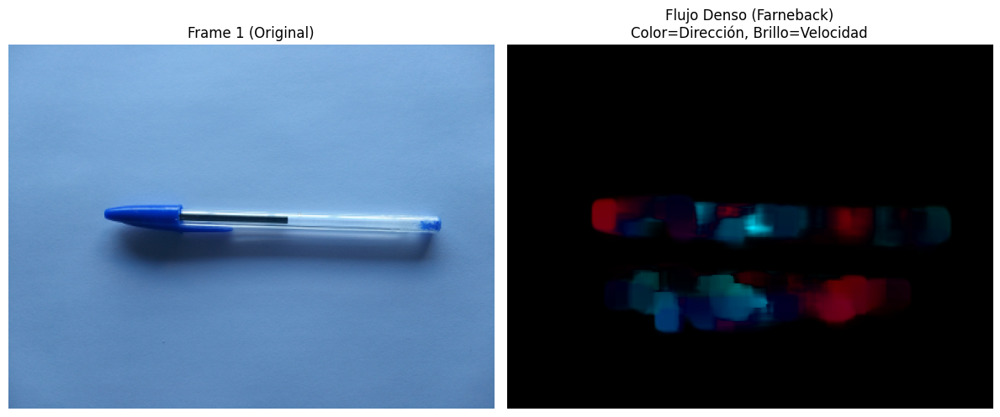

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import sys

img1 = cv2.imread('img1.jpg')
img2 = cv2.imread('img2.jpg')

if img1 is None or img2 is None:
    print("Error: No se encontraron las imágenes.")
    sys.exit()

# Redimensionar si es necesario (Farneback es pesado, mejor imágenes no gigantes)
if img1.shape != img2.shape:
    img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]))

# Convertir a escala de grises
prvs = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
next_img = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# ALGORITMO FARNEBACK 
# Calcula el flujo para TODOS los píxeles
# flow tendrá dimensiones (alto, ancho, 2). El '2' son los vectores (dx, dy)
flow = cv2.calcOpticalFlowFarneback(prvs, next_img, None, 
                                    pyr_scale=0.5, levels=3, winsize=15, 
                                    iterations=3, poly_n=5, poly_sigma=1.2, flags=0)

#  PREPARAR VISUALIZACIÓN HSV 
# Creamos una imagen vacía con 3 canales (Hue, Saturation, Value)
hsv = np.zeros_like(img1)

# Ponemos la Saturación al máximo (255) para colores vivos
hsv[..., 1] = 255

# --- CONVERSIÓN CARTESIANA A POLAR ---
# Convertimos los vectores (x, y) a (Magnitud, Ángulo)
# mag: Qué tan rápido se mueve
# ang: Hacia dónde se mueve
mag, ang = cv2.cartToPolar(flow[..., 0], flow[..., 1])

#  El ÁNGULO determina el COLOR (Hue)
# Convertimos radianes a grados (OpenCV usa 0-180 para Hue)
hsv[..., 0] = ang * 180 / np.pi / 2

#  La MAGNITUD determina el BRILLO (Value)
# Normalizamos para que se vea bien (0 a 255)
hsv[..., 2] = cv2.normalize(mag, None, 0, 255, cv2.NORM_MINMAX)

# Convertir de HSV a BGR para mostrarlo
bgr_flow = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
plt.title("Frame 1 (Original)")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(bgr_flow, cv2.COLOR_BGR2RGB))
plt.title("Flujo Denso (Farneback)\nColor=Dirección, Brillo=Velocidad")
plt.axis('off')

plt.tight_layout()
plt.show()


## 5. Implementación del Filtro de Kalman

In [5]:
import cv2
import numpy as np

# Lienzo negro
frame = np.zeros((600, 800, 3), np.uint8)

# CONFIGURACIÓN KALMAN 
# 4 variables de estado (x, y, dx, dy), 2 de medición (x, y)
kalman = cv2.KalmanFilter(4, 2)
kalman.measurementMatrix = np.array([[1,0,0,0], [0,1,0,0]], np.float32) # Solo medimos posición
kalman.transitionMatrix = np.array([[1,0,1,0], [0,1,0,1], [0,0,1,0], [0,0,0,1]], np.float32) # Física básica
kalman.processNoiseCov = np.eye(4, dtype=np.float32) * 0.03

# Función para capturar mouse
last_measurement = current_measurement = np.array((2,1), np.float32)
def mousemove(event, x, y, flags, param):
    global current_measurement, last_measurement
    last_measurement = current_measurement
    current_measurement = np.array([[np.float32(x)], [np.float32(y)]])

cv2.namedWindow("Kalman Tracker")
cv2.setMouseCallback("Kalman Tracker", mousemove)

while True:
    #  PREDECIR (El cuadrado VERDE es donde la IA cree que estarás)
    prediction = kalman.predict()
    pred_x, pred_y = int(prediction[0]), int(prediction[1])
    
    #  CORREGIR (Usamos la posición real del mouse)
    kalman.correct(current_measurement)
    
    # Dibujar
    cv2.line(frame, (int(last_measurement[0]), int(last_measurement[1])), 
             (int(current_measurement[0]), int(current_measurement[1])), (0,255,0), 1) # Ruta real
    
    cv2.rectangle(frame, (pred_x-10, pred_y-10), (pred_x+10, pred_y+10), (0,0,255), 2) # Predicción (Rojo)
    
    cv2.imshow("Kalman Tracker", frame)
    if cv2.waitKey(30) & 0xFF == 27: break # ESC para salir

cv2.destroyAllWindows()


/tmp/ipykernel_15647/3192202856.py:27: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  pred_x, pred_y = int(prediction[0]), int(prediction[1])
/tmp/ipykernel_15647/3192202856.py:33: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cv2.line(frame, (int(last_measurement[0]), int(last_measurement[1])),
/tmp/ipykernel_15647/3192202856.py:34: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  (int(current_measurement[0]), int(current_measurement[1])), (0,255,0), 1) # Ruta real


## 6.Seguimiento mediante Mean Shift

In [6]:
import cv2
import numpy as np

cap = cv2.VideoCapture(0) # Usa la webcam

# Tomar el primer frame
ret, frame = cap.read()
# Selecciona manualmente el objeto a rastrear (haz un recuadro con el mouse y pulsa ENTER)
r, h, c, w = cv2.selectROI("Selecciona Objeto", frame, False)
track_window = (c, r, w, h)

# Configurar la ROI para el rastreo
roi = frame[r:r+h, c:c+w]
hsv_roi = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)
# Creamos una máscara para ignorar colores con poca luz (ruido)
mask = cv2.inRange(hsv_roi, np.array((0., 60., 32.)), np.array((180., 255., 255.)))
roi_hist = cv2.calcHist([hsv_roi], [0], mask, [180], [0, 180])
cv2.normalize(roi_hist, roi_hist, 0, 255, cv2.NORM_MINMAX)

term_crit = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 1)

while(1):
    ret, frame = cap.read()
    if ret == True:
        hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
        # Retroproyección: Probabilidad de que cada píxel pertenezca al objeto
        dst = cv2.calcBackProject([hsv], [0], roi_hist, [0, 180], 1)
        # Aplicamos Mean Shift para mover la ventana hacia la máxima densidad
        ret, track_window = cv2.meanShift(dst, track_window, term_crit)
        
        # Dibujar resultado
        x,y,w,h = track_window
        img2 = cv2.rectangle(frame, (x,y), (x+w,y+h), 255,2)
        cv2.imshow('Seguimiento Mean Shift',img2)
        
        if cv2.waitKey(1) & 0xFF == 27: break
    else: break
cap.release()
cv2.destroyAllWindows()


Select a ROI and then press SPACE or ENTER button!
Cancel the selection process by pressing c button!


## 7. Algoritmo CamShift

In [7]:

import cv2
import numpy as np

cap = cv2.VideoCapture(0) # Usa la webcam

# Tomar el primer frame
ret, frame = cap.read()
# Selecciona manualmente el objeto a rastrear (haz un recuadro con el mouse y pulsa ENTER)
r, h, c, w = cv2.selectROI("Selecciona Objeto", frame, False)
track_window = (c, r, w, h)

# Configurar la ROI para el rastreo
roi = frame[r:r+h, c:c+w]
hsv_roi = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)
# Creamos una máscara para ignorar colores con poca luz (ruido)
mask = cv2.inRange(hsv_roi, np.array((0., 60., 32.)), np.array((180., 255., 255.)))
roi_hist = cv2.calcHist([hsv_roi], [0], mask, [180], [0, 180])
cv2.normalize(roi_hist, roi_hist, 0, 255, cv2.NORM_MINMAX)

term_crit = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 1)

while(1):
    ret, frame = cap.read()
    if ret == True:
        hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
        dst = cv2.calcBackProject([hsv],[0],roi_hist,[0,180],1)
        
        # Usamos CamShift 
        ret, track_window = cv2.CamShift(dst, track_window, term_crit)
        
        # Dibujar una caja rotada que se adapta al tamaño
        pts = cv2.boxPoints(ret)
        pts = np.int64(pts)
        img2 = cv2.polylines(frame, [pts], True, (0, 255, 255), 2)
        
        cv2.imshow('Seguimiento CamShift', img2)
        if cv2.waitKey(1) & 0xFF == 27: break
    else: break

cap.release()
cv2.destroyAllWindows()


Select a ROI and then press SPACE or ENTER button!
Cancel the selection process by pressing c button!


## 8. Filtrado de Partículas (Algoritmo CONDENSATION)

In [8]:
import numpy as np
import cv2

# Configuración
n_particles = 200
width, height = 800, 600
particles = np.random.rand(n_particles, 2) * [width, height] # Partículas aleatorias
# Mouse actúa como el objeto real a rastrear
target = np.array([width/2, height/2])
def mouse(event, x, y, flags, param):
    global target
    target = np.array([x, y])

cv2.namedWindow('Particle Filter')
cv2.setMouseCallback('Particle Filter', mouse)
while True:
    frame = np.zeros((height, width, 3), dtype=np.uint8)    
    #  PREDICCIÓN (Mover partículas + Ruido)
    noise = np.random.randn(n_particles, 2) * 15
    particles += noise
    # EVALUACIÓN (Calcular pesos)
    # Las partículas cerca del mouse (target) pesan más
    dist = np.linalg.norm(particles - target, axis=1)
    # Función Gaussiana de similitud: más cerca = peso más alto (hasta 1.0)
    weights = np.exp(-dist**2 / (2 * 50**2))
    weights /= np.sum(weights) # Normalizar para que sumen 1
    
    #  REMUESTREO (Supervivencia del más apto)
    # Seleccionamos índices basados en su peso
    indices = np.random.choice(np.arange(n_particles), size=n_particles, p=weights)
    particles = particles[indices]    
    # Visualización
    for p in particles:
        cv2.circle(frame, (int(p[0]), int(p[1])), 2, (255, 0, 0), -1) # Partículas azules
    
    cv2.circle(frame, (int(target[0]), int(target[1])), 10, (0, 0, 255), -1) # Objetivo Rojo    
    # Centro de masa estimado (la "respuesta" del filtro)
    estimated = np.mean(particles, axis=0)
    cv2.circle(frame, (int(estimated[0]), int(estimated[1])), 5, (0, 255, 255), 2) # Estimación Amarilla

    cv2.imshow('Particle Filter', frame)
    if cv2.waitKey(20) & 0xFF == 27: break

cv2.destroyAllWindows()


## 9. Seguimiento de Puntos mediante Lucas-Kanade

In [9]:
import numpy as np
import cv2

cap = cv2.VideoCapture(0)
# Parámetros ShiTomasi y LucasKanade
feature_params = dict(maxCorners=100, qualityLevel=0.3, minDistance=7, blockSize=7)
lk_params = dict(winSize=(15, 15), maxLevel=2, criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))
# Color aleatorio para cada punto
color = np.random.randint(0, 255, (100, 3))
# Tomar primer frame y detectar esquinas
ret, old_frame = cap.read()
old_gray = cv2.cvtColor(old_frame, cv2.COLOR_BGR2GRAY)
p0 = cv2.goodFeaturesToTrack(old_gray, mask=None, **feature_params)
# Crear máscara para dibujar rastros
mask = np.zeros_like(old_frame)

while(1):
    ret, frame = cap.read()
    if not ret: break
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    # CALCULAR FLUJO OPTICO
    p1, st, err = cv2.calcOpticalFlowPyrLK(old_gray, frame_gray, p0, None, **lk_params)
    # Seleccionar puntos buenos
    if p1 is not None:
        good_new = p1[st==1]
        good_old = p0[st==1]
    # Dibujar rastros
    for i, (new, old) in enumerate(zip(good_new, good_old)):
        a, b = new.ravel()
        c, d = old.ravel()
        mask = cv2.line(mask, (int(a), int(b)), (int(c), int(d)), color[i].tolist(), 2)
        frame = cv2.circle(frame, (int(a), int(b)), 5, color[i].tolist(), -1)
    
    img = cv2.add(frame, mask)
    cv2.imshow('Lucas-Kanade Object Tracker', img)

    # Actualizar frame anterior y puntos
    old_gray = frame_gray.copy()
    p0 = good_new.reshape(-1, 1, 2)

    if cv2.waitKey(1) & 0xFF == 27: break

cv2.destroyAllWindows()
